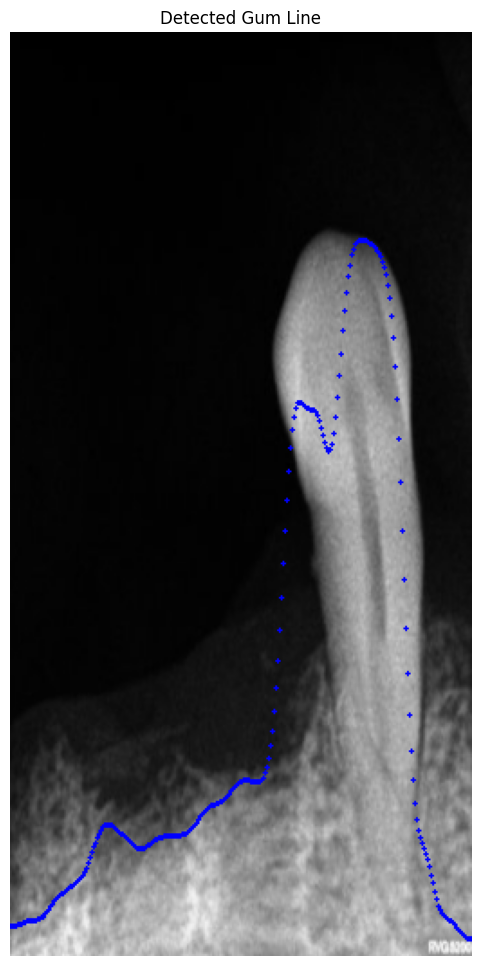

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d

# Load image in grayscale
img = cv2.imread("image 7.jpg", cv2.IMREAD_GRAYSCALE)

# Resize (optional) for faster processing
img_resized = cv2.resize(img, (256, 512))

# Get dimensions
height, width = img_resized.shape

# Initialize gum line (y-coordinates)
gum_line_y = []

# Analyze column-by-column to find the sharpest transition (gum border)
for x in range(width):
    column = img_resized[:, x]
    
    # Apply smoothing to remove noise
    smoothed = gaussian_filter1d(column, sigma=2)

    # Compute first derivative (edge detection)
    gradient = np.gradient(smoothed)

    # Find peak (highest positive slope: light to dark transition)
    peak_index = np.argmax(gradient)
    gum_line_y.append(peak_index)

# Smooth the gum line
gum_line_y = gaussian_filter1d(gum_line_y, sigma=5)

# Plot on original image
img_color = cv2.cvtColor(img_resized, cv2.COLOR_GRAY2BGR)

# Draw the gum line in red
for x in range(width):
    y = int(gum_line_y[x])
    cv2.circle(img_color, (x, y), 1, (0, 0, 255), -1)

# Show result
plt.figure(figsize=(10, 12))
plt.title("Detected Gum Line")
plt.imshow(img_color)
plt.axis('off')
plt.show()


In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d

# Load image in grayscale
img = cv2.imread("image 7.jpg", cv2.IMREAD_GRAYSCALE)

# Resize for processing (optional)
img_resized = cv2.resize(img, (256, 512))
height, width = img_resized.shape

# Detect gum line by analyzing brightness gradient in each column
gum_line_y = []
for x in range(width):
    column = img_resized[:, x]
    smoothed = gaussian_filter1d(column, sigma=2)
    gradient = np.gradient(smoothed)
    peak_index = np.argmax(gradient)
    gum_line_y.append(peak_index)

# Smooth the curve
gum_line_y = gaussian_filter1d(gum_line_y, sigma=5)

# Plot only the gum line (black background + red line)
plt.figure(figsize=(10, 6))
plt.title("Extracted Gum Line")
plt.plot(gum_line_y, color='red', linewidth=2)
plt.gca().invert_yaxis()  # Flip y-axis to match image orientation
plt.axis('off')
plt.show()


error: OpenCV(4.9.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:4152: error: (-215:Assertion failed) !ssize.empty() in function 'cv::resize'


In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d, binary_dilation, binary_erosion
from skimage.morphology import skeletonize
from scipy import ndimage


In [3]:

!pip install torch torchvision opencv-python matplotlib scikit-image scipy numpy
!pip install efficientnet-pytorch 



[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16464 sha256=c1e980080143e04388cb5e3ae960e883f5109f041bb0c71d7dd605b0604e174a
  Stored in directory: c:\users\yash chaudhary\appdata\local\pip\cache\wheels\8b\6f\9b\231a832f811ab6ebb1b32455b177ffc6b8b1cd8de19de70c09
Successfully built efficientnet-pytorch



[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from skimage.morphology import skeletonize
from scipy.ndimage import gaussian_filter1d
import json
from tqdm import tqdm


In [5]:
class DentalRadiographDataset(Dataset):
    def __init__(self, image_paths, transform=None, target_size=(256, 256)):
        self.image_paths = image_paths
        self.transform = transform
        self.target_size = target_size
        
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        # Load image
        img_path = self.image_paths[idx]
        image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        
        # Apply CLAHE for contrast enhancement
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        enhanced = clahe.apply(image)
        
        # Resize
        resized = cv2.resize(enhanced, self.target_size)
        
        # Normalize
        normalized = resized / 255.0
        
        # Add channel dimension
        normalized = np.expand_dims(normalized, axis=0)
        
        # Convert to tensor
        image_tensor = torch.from_numpy(normalized).float()
        
        if self.transform:
            image_tensor = self.transform(image_tensor)
            
        return image_tensor, img_path


In [6]:
class TwoStreamCoordinateAttention(nn.Module):
    def __init__(self, inp, oup, reduction=32):
        super(TwoStreamCoordinateAttention, self).__init__()
        self.pool_h = nn.AdaptiveAvgPool2d((None, 1))
        self.pool_w = nn.AdaptiveAvgPool2d((1, None))
        
        # Add max pooling stream for boundary enhancement
        self.pool_h_max = nn.AdaptiveMaxPool2d((None, 1))
        self.pool_w_max = nn.AdaptiveMaxPool2d((1, None))
        
        mip = max(8, inp // reduction)
        
        self.conv1 = nn.Conv2d(inp, mip, kernel_size=1, stride=1, padding=0)
        self.bn1 = nn.BatchNorm2d(mip)
        self.act = nn.ReLU()
        
        self.conv_h = nn.Conv2d(mip, oup, kernel_size=1, stride=1, padding=0)
        self.conv_w = nn.Conv2d(mip, oup, kernel_size=1, stride=1, padding=0)
        
    def forward(self, x):
        identity = x
        
        n, c, h, w = x.size()
        
        # Average pooling streams
        x_h = self.pool_h(x)
        x_w = self.pool_w(x).permute(0, 1, 3, 2)
        
        # Max pooling streams - critical for detecting edge features
        x_h_max = self.pool_h_max(x)
        x_w_max = self.pool_w_max(x).permute(0, 1, 3, 2)
        
        # Combine avg and max streams
        x_h = x_h + x_h_max
        x_w = x_w + x_w_max
        
        y = torch.cat([x_h, x_w], dim=2)
        y = self.conv1(y)
        y = self.bn1(y)
        y = self.act(y)
        
        x_h, x_w = torch.split(y, [h, w], dim=2)
        x_w = x_w.permute(0, 1, 3, 2)
        
        a_h = self.conv_h(x_h).sigmoid()
        a_w = self.conv_w(x_w).sigmoid()
        
        out = identity * a_w * a_h
        
        return out


In [7]:
class OmniDimConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OmniDimConvBlock, self).__init__()
        self.conv1x1 = nn.Conv2d(in_channels, out_channels, kernel_size=1)
        self.conv3x3 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.conv5x5 = nn.Conv2d(in_channels, out_channels, kernel_size=5, padding=2)
        self.bn = nn.BatchNorm2d(out_channels * 3)
        self.relu = nn.ReLU(inplace=True)
        self.fusion = nn.Conv2d(out_channels * 3, out_channels, kernel_size=1)
        
    def forward(self, x):
        x1 = self.conv1x1(x)
        x3 = self.conv3x3(x)
        x5 = self.conv5x5(x)
        
        x_cat = torch.cat([x1, x3, x5], dim=1)
        x_cat = self.bn(x_cat)
        x_cat = self.relu(x_cat)
        
        out = self.fusion(x_cat)
        return out

class ResidualOmniDimConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ResidualOmniDimConv, self).__init__()
        self.conv_block = OmniDimConvBlock(in_channels, out_channels)
        self.shortcut = nn.Conv2d(in_channels, out_channels, kernel_size=1) if in_channels != out_channels else nn.Identity()
        self.relu = nn.ReLU(inplace=True)
        
    def forward(self, x):
        residual = self.shortcut(x)
        out = self.conv_block(x)
        out += residual
        out = self.relu(out)
        return out


In [8]:
class CrossLayerFusion(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(CrossLayerFusion, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        return x


In [9]:
class GumLineDetectionModel(nn.Module):
    def __init__(self, in_channels=1):
        super(GumLineDetectionModel, self).__init__()
        
        # Encoder
        self.enc1 = nn.Sequential(
            ResidualOmniDimConv(in_channels, 64),
            TwoStreamCoordinateAttention(64, 64)
        )
        self.pool1 = nn.MaxPool2d(2)
        
        self.enc2 = nn.Sequential(
            ResidualOmniDimConv(64, 128),
            TwoStreamCoordinateAttention(128, 128)
        )
        self.pool2 = nn.MaxPool2d(2)
        
        self.enc3 = nn.Sequential(
            ResidualOmniDimConv(128, 256),
            TwoStreamCoordinateAttention(256, 256)
        )
        self.pool3 = nn.MaxPool2d(2)
        
        self.enc4 = nn.Sequential(
            ResidualOmniDimConv(256, 512),
            TwoStreamCoordinateAttention(512, 512)
        )
        self.pool4 = nn.MaxPool2d(2)
        
        self.bottleneck = ResidualOmniDimConv(512, 1024)
        
        # Decoder
        self.upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec4 = CrossLayerFusion(1024, 512)  # 512 + 512 input
        
        self.upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec3 = CrossLayerFusion(512, 256)  # 256 + 256 input
        
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec2 = CrossLayerFusion(256, 128)  # 128 + 128 input
        
        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec1 = CrossLayerFusion(128, 64)  # 64 + 64 input
        
        # Output layers
        self.teeth_seg = nn.Conv2d(64, 1, kernel_size=1)
        self.gum_line = nn.Conv2d(64, 1, kernel_size=1)
        
    def forward(self, x):
        # Encoder
        enc1 = self.enc1(x)
        p1 = self.pool1(enc1)
        
        enc2 = self.enc2(p1)
        p2 = self.pool2(enc2)
        
        enc3 = self.enc3(p2)
        p3 = self.pool3(enc3)
        
        enc4 = self.enc4(p3)
        p4 = self.pool4(enc4)
        
        bottleneck = self.bottleneck(p4)
        
        # Decoder
        d4 = self.upconv4(bottleneck)
        d4 = torch.cat((enc4, d4), dim=1)
        d4 = self.dec4(d4)
        
        d3 = self.upconv3(d4)
        d3 = torch.cat((enc3, d3), dim=1)
        d3 = self.dec3(d3)
        
        d2 = self.upconv2(d3)
        d2 = torch.cat((enc2, d2), dim=1)
        d2 = self.dec2(d2)
        
        d1 = self.upconv1(d2)
        d1 = torch.cat((enc1, d1), dim=1)
        d1 = self.dec1(d1)
        
        # Output segmentation and gum line
        teeth_seg = torch.sigmoid(self.teeth_seg(d1))
        gum_line = torch.sigmoid(self.gum_line(d1))
        
        return teeth_seg, gum_line


In [10]:
def post_process_gum_line(gum_line_pred, teeth_mask, threshold=0.5):
    """
    Process gum line prediction to create gaps where teeth are present
    """
    # Convert tensors to numpy arrays
    if isinstance(gum_line_pred, torch.Tensor):
        gum_line_pred = gum_line_pred.detach().cpu().numpy()
    if isinstance(teeth_mask, torch.Tensor):
        teeth_mask = teeth_mask.detach().cpu().numpy()
    
    # Threshold predictions
    gum_line_binary = (gum_line_pred > threshold).astype(np.uint8)
    teeth_binary = (teeth_mask > threshold).astype(np.uint8)
    
    # Thin the gum line to single pixel width
    gum_line_skeleton = skeletonize(gum_line_binary)
    
    # Create the gapped gum line by removing where teeth are detected
    gapped_gum_line = gum_line_skeleton.copy()
    gapped_gum_line[teeth_binary > 0] = 0
    
    # Find connected components
    connectivity = 8  # 8-connectivity
    num_labels, labels = cv2.connectedComponents(gapped_gum_line.astype(np.uint8), connectivity=connectivity)
    
    # Filter small components (noise)
    min_size = 10
    for i in range(1, num_labels):
        if np.sum(labels == i) < min_size:
            gapped_gum_line[labels == i] = 0
    
    return gapped_gum_line

def extract_gum_line_coordinates(gum_line_mask):
    """
    Extract coordinates of gum line points from binary mask
    """
    y_indices, x_indices = np.where(gum_line_mask > 0)
    
    # Sort points by x coordinate to get ordered gum line
    sorted_indices = np.argsort(x_indices)
    sorted_x = x_indices[sorted_indices]
    sorted_y = y_indices[sorted_indices]
    
    # Group by x-coordinate (there might be multiple y values for one x)
    unique_x = np.unique(sorted_x)
    gum_line_points = []
    
    for x in unique_x:
        y_values = sorted_y[sorted_x == x]
        # Use the median y value if multiple exist
        median_y = int(np.median(y_values))
        gum_line_points.append((int(x), median_y))
    
    return gum_line_points


In [11]:
def visualize_results(image, teeth_mask, gum_line_mask, gum_line_points=None):
    """
    Visualize segmentation and gum line detection results
    """
    # Create RGB visualizations
    if len(image.shape) == 2 or image.shape[2] == 1:
        img_rgb = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
    else:
        img_rgb = image.copy()
    
    # Teeth segmentation overlay
    teeth_overlay = img_rgb.copy()
    teeth_binary = (teeth_mask > 0.5).astype(np.uint8)
    teeth_overlay[teeth_binary > 0] = [0, 0, 255]  # Red for teeth regions
    
    # Gum line overlay
    gum_line_overlay = img_rgb.copy()
    if gum_line_points:
        for x, y in gum_line_points:
            cv2.circle(gum_line_overlay, (x, y), 1, (0, 255, 0), -1)
    else:
        gum_line_binary = (gum_line_mask > 0).astype(np.uint8)
        gum_line_overlay[gum_line_binary > 0] = [0, 255, 0]  # Green for gum line
    
    # Plot results
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 2, 1)
    plt.imshow(img_rgb)
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    plt.imshow(teeth_overlay)
    plt.title('Teeth Segmentation')
    plt.axis('off')
    
    plt.subplot(2, 2, 3)
    plt.imshow(gum_line_overlay)
    plt.title('Gum Line Detection')
    plt.axis('off')
    
    # Display just the gum line on black background
    plt.subplot(2, 2, 4)
    black_bg = np.zeros_like(img_rgb)
    if gum_line_points:
        for x, y in gum_line_points:
            cv2.circle(black_bg, (x, y), 1, (0, 255, 0), -1)
    else:
        black_bg[gum_line_mask > 0] = [0, 255, 0]
    plt.imshow(black_bg)
    plt.title('Gum Line Only')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()


In [12]:
def process_single_image(image_path, model, device='cuda' if torch.cuda.is_available() else 'cpu'):
    """
    Process a single dental radiograph for gum line detection
    """
    # Load and preprocess image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        print(f"Error loading image: {image_path}")
        return None
    
    original_size = image.shape
    
    # Preprocess
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(image)
    resized = cv2.resize(enhanced, (256, 256))
    normalized = resized / 255.0
    
    # Convert to tensor
    input_tensor = torch.from_numpy(normalized).float().unsqueeze(0).unsqueeze(0).to(device)
    
    # Model prediction
    model.eval()
    with torch.no_grad():
        teeth_pred, gum_line_pred = model(input_tensor)
    
    # Convert to numpy for post-processing
    teeth_np = teeth_pred[0, 0].cpu().numpy()
    gum_line_np = gum_line_pred[0, 0].cpu().numpy()
    
    # Post-process to create gaps at teeth positions
    gapped_gum_line = post_process_gum_line(gum_line_np, teeth_np)
    
    # Extract gum line coordinates
    gum_line_points = extract_gum_line_coordinates(gapped_gum_line)
    
    # Visualize results
    visualize_results(resized, teeth_np, gapped_gum_line, gum_line_points)
    
    return {
        'teeth_mask': teeth_np,
        'gum_line_mask': gapped_gum_line,
        'gum_line_points': gum_line_points
    }


In [13]:
def train_model(model, train_loader, val_loader, num_epochs=100, device='cuda'):
    """
    Train the gum line detection model
    """
    model = model.to(device)
    
    # Define loss function
    bce_loss = nn.BCELoss()
    
    # Define optimizer
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
    
    # Learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)
    
    # Training loop
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        
        for batch_idx, (inputs, targets_teeth, targets_gum) in enumerate(train_loader):
            inputs = inputs.to(device)
            targets_teeth = targets_teeth.to(device)
            targets_gum = targets_gum.to(device)
            
            # Zero the parameter gradients
            optimizer.zero_grad()
            
            # Forward pass
            outputs_teeth, outputs_gum = model(inputs)
            
            # Calculate loss
            loss_teeth = bce_loss(outputs_teeth, targets_teeth)
            loss_gum = bce_loss(outputs_gum, targets_gum)
            loss = loss_teeth + loss_gum
            
            # Backward pass and optimize
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            
        # Calculate average training loss
        train_loss /= len(train_loader)
        
        # Validation
        model.eval()
        val_loss = 0
        
        with torch.no_grad():
            for inputs, targets_teeth, targets_gum in val_loader:
                inputs = inputs.to(device)
                targets_teeth = targets_teeth.to(device)
                targets_gum = targets_gum.to(device)
                
                # Forward pass
                outputs_teeth, outputs_gum = model(inputs)
                
                # Calculate loss
                loss_teeth = bce_loss(outputs_teeth, targets_teeth)
                loss_gum = bce_loss(outputs_gum, targets_gum)
                loss = loss_teeth + loss_gum
                
                val_loss += loss.item()
        
        # Calculate average validation loss
        val_loss /= len(val_loader)
        
        # Update learning rate
        scheduler.step(val_loss)
        
        print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}')
        
        # Save checkpoint
        if (epoch + 1) % 10 == 0:
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': val_loss,
            }, f'gum_line_model_epoch_{epoch+1}.pth')
    
    return model


In [14]:
def process_image_batch(image_folder, output_folder, model, device='cuda'):
    """
    Process a folder of dental radiographs for gum line detection
    """
    # Create output directory if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)
    
    # Get all image files
    image_files = [f for f in os.listdir(image_folder) 
                  if f.endswith(('.jpg', '.jpeg', '.png'))]
    
    # Process each image
    results = []
    for img_file in tqdm(image_files):
        img_path = os.path.join(image_folder, img_file)
        
        # Process image
        result = process_single_image(img_path, model, device)
        
        if result:
            # Store results
            results.append({
                'image_name': img_file,
                'gum_line_points': [(int(x), int(y)) for x, y in result['gum_line_points']]
            })
            
            # Save visualization
            plt.savefig(os.path.join(output_folder, f"result_{img_file}"))
            plt.close()
    
    # Save aggregated results to JSON
    with open(os.path.join(output_folder, 'gum_line_results.json'), 'w') as f:
        json.dump(results, f)
    
    return results


Using model on device: cpu
Found 51 images to process


  0%|                                                                                           | 0/51 [00:00<?, ?it/s]

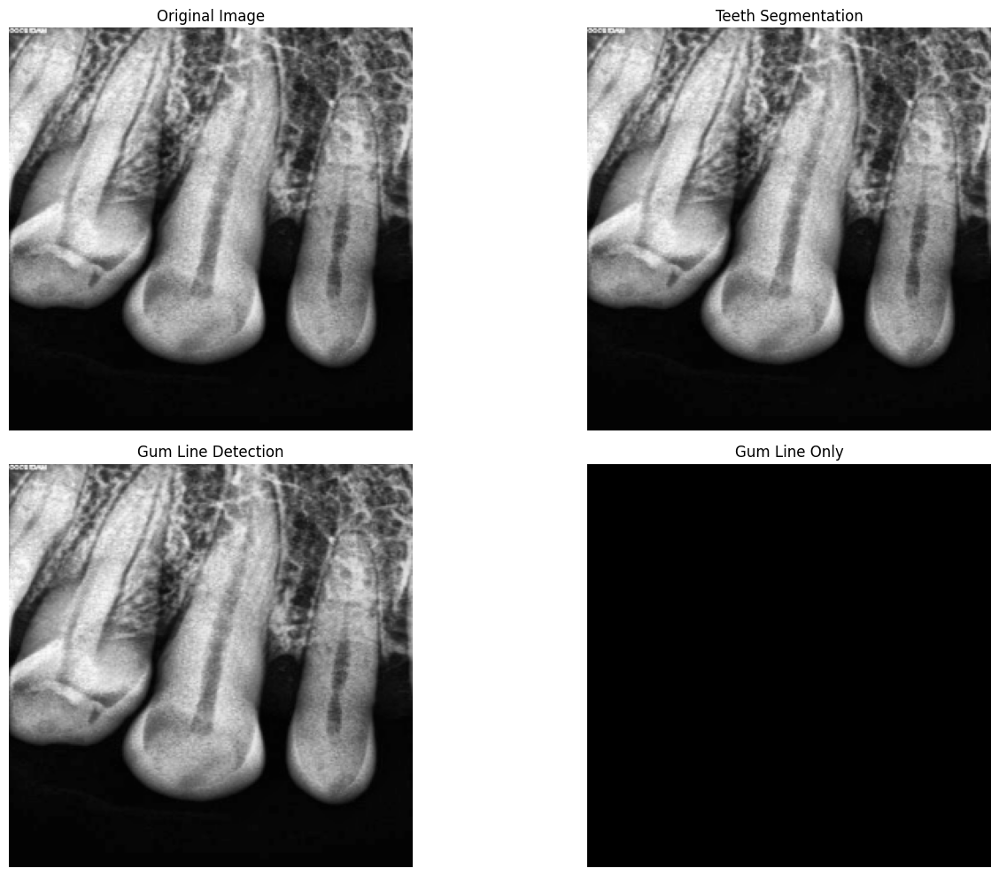

  2%|█▋                                                                                 | 1/51 [00:01<01:14,  1.48s/it]

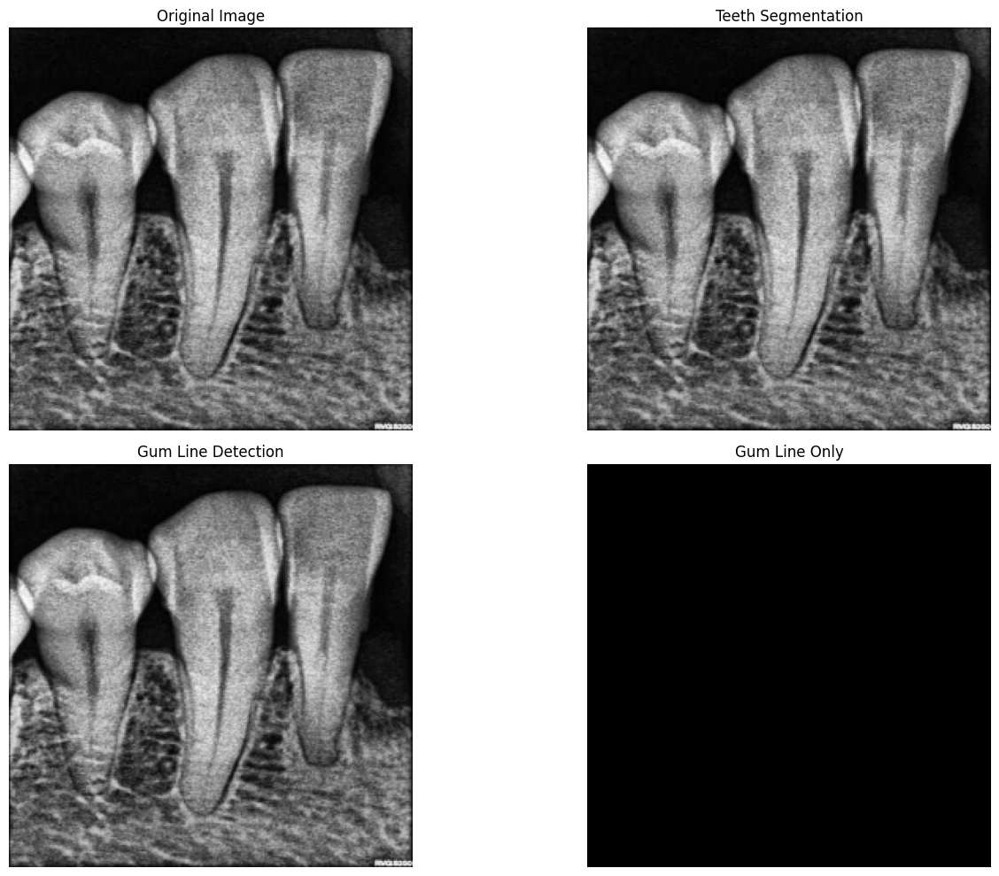

  4%|███▎                                                                               | 2/51 [00:02<01:02,  1.28s/it]

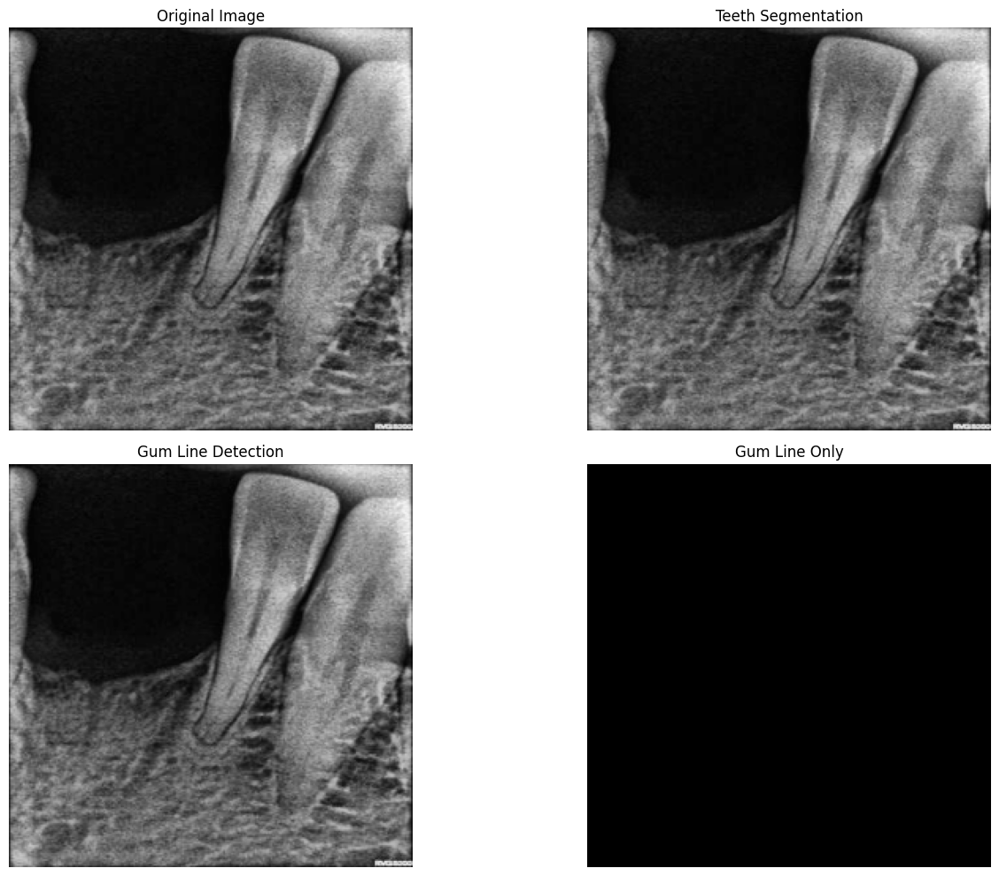

  6%|████▉                                                                              | 3/51 [00:03<00:58,  1.22s/it]

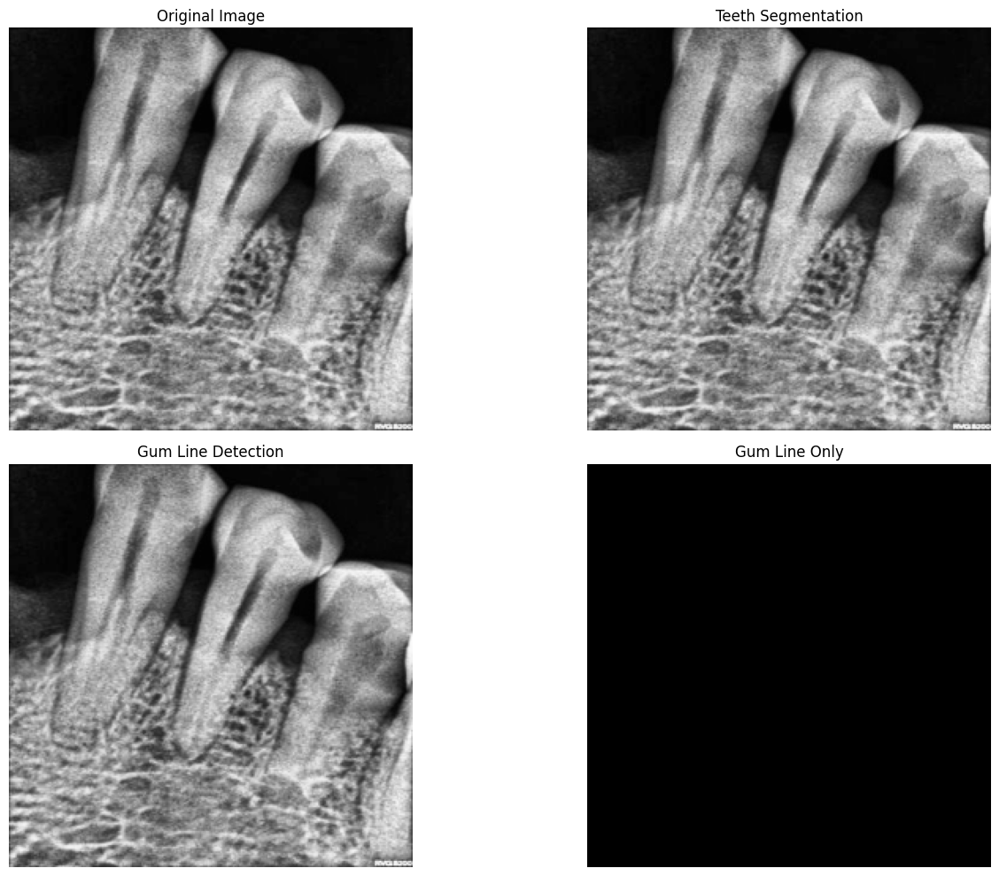

  8%|██████▌                                                                            | 4/51 [00:04<00:56,  1.21s/it]

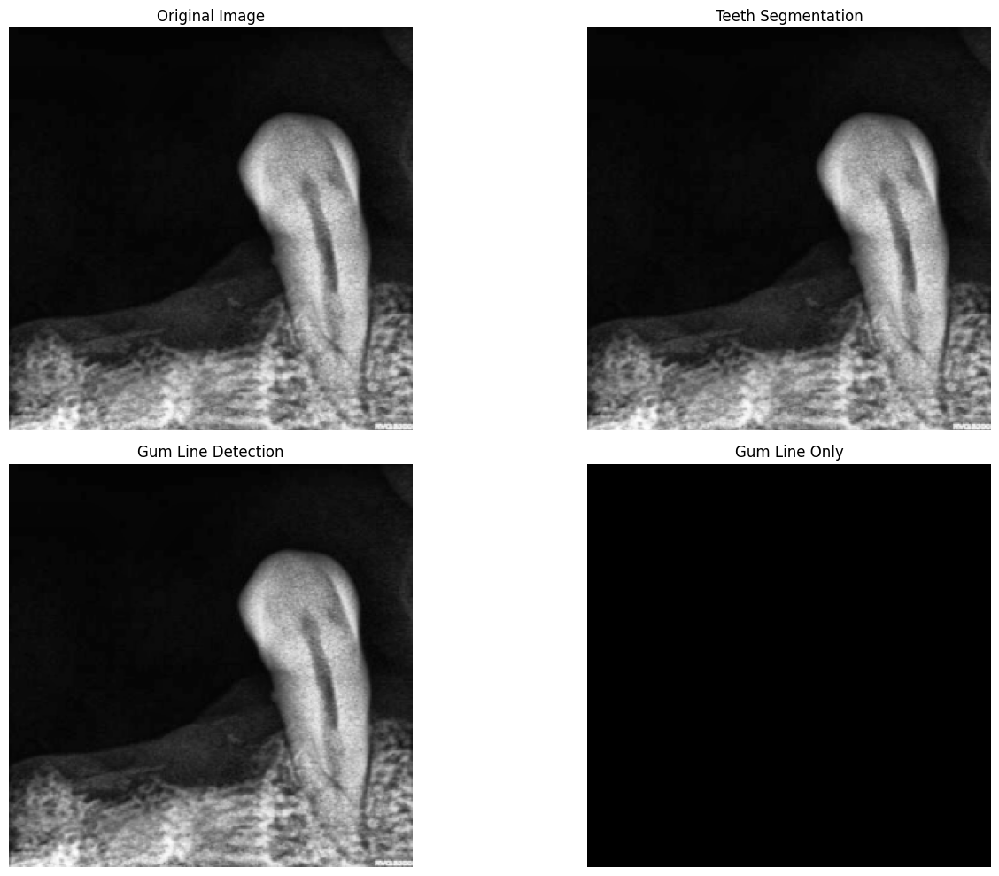

 10%|████████▏                                                                          | 5/51 [00:06<00:55,  1.21s/it]

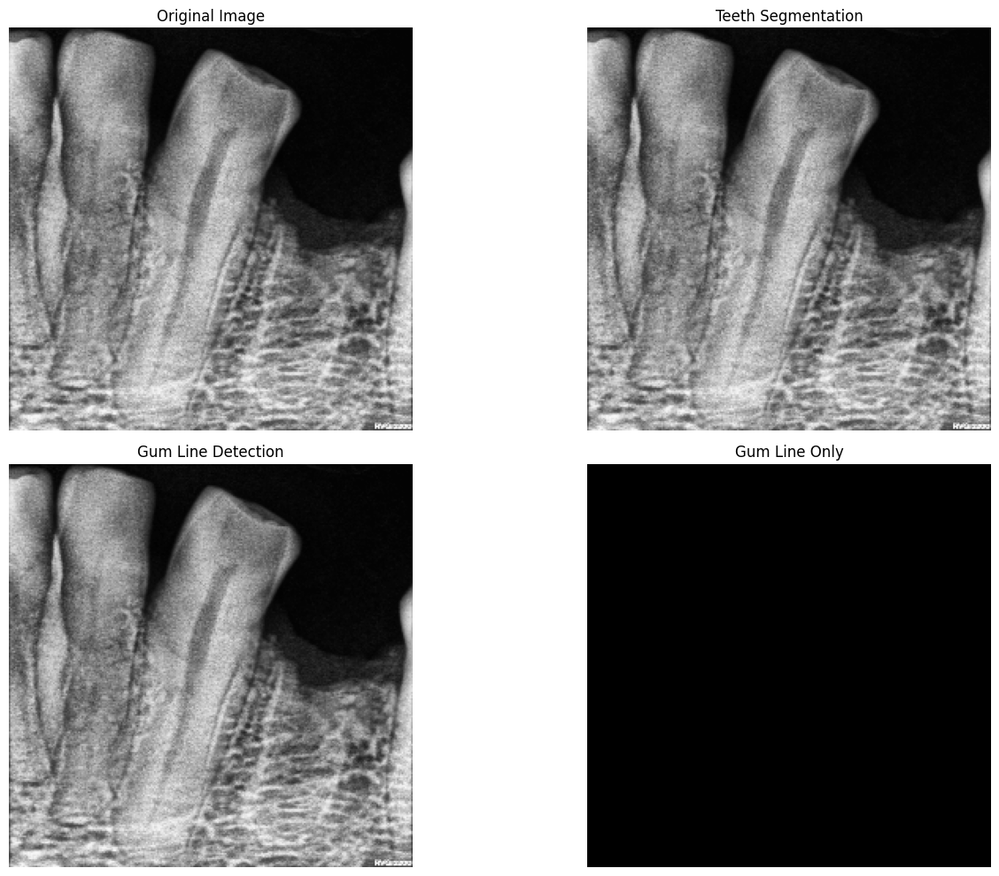

 12%|█████████▊                                                                         | 6/51 [00:07<00:54,  1.20s/it]

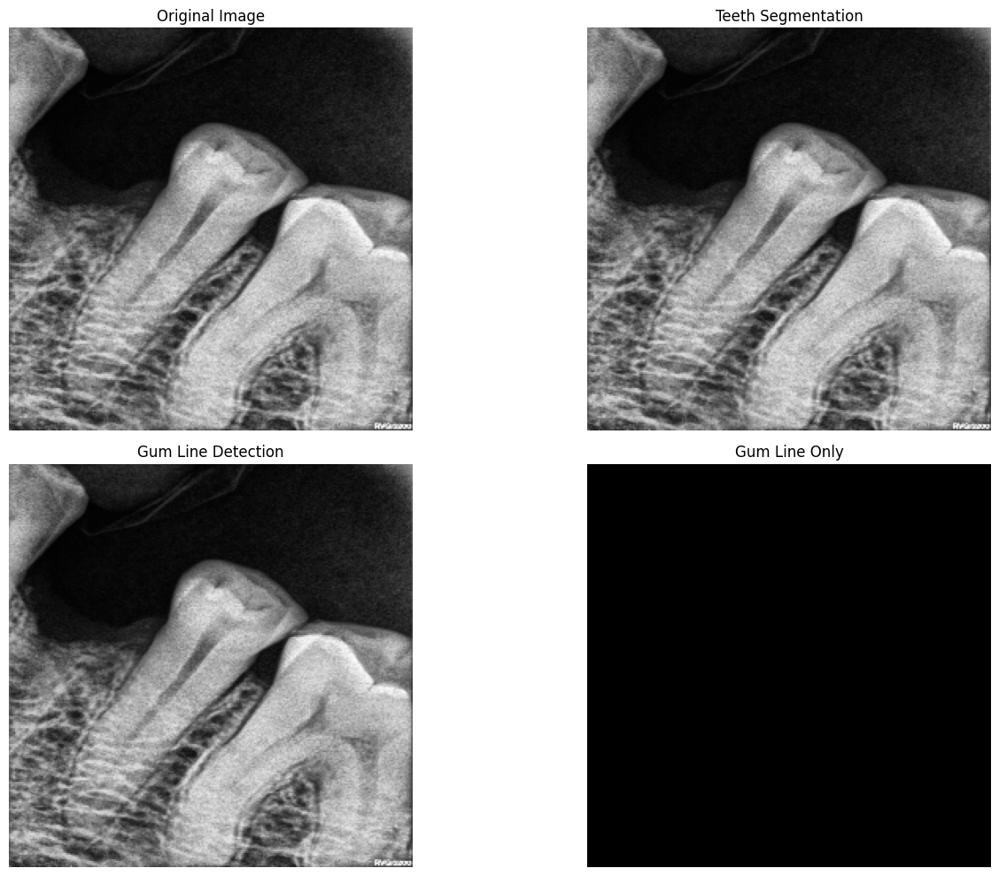

 14%|███████████▍                                                                       | 7/51 [00:08<00:52,  1.19s/it]

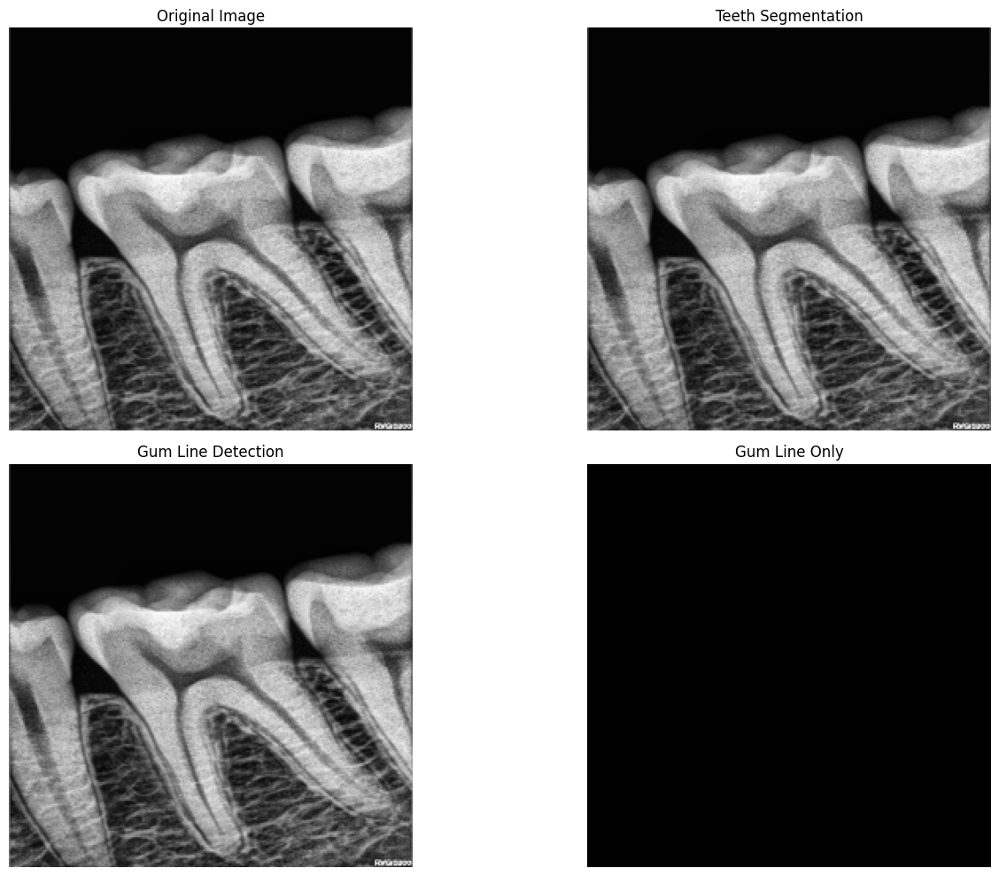

 16%|█████████████                                                                      | 8/51 [00:09<00:50,  1.17s/it]

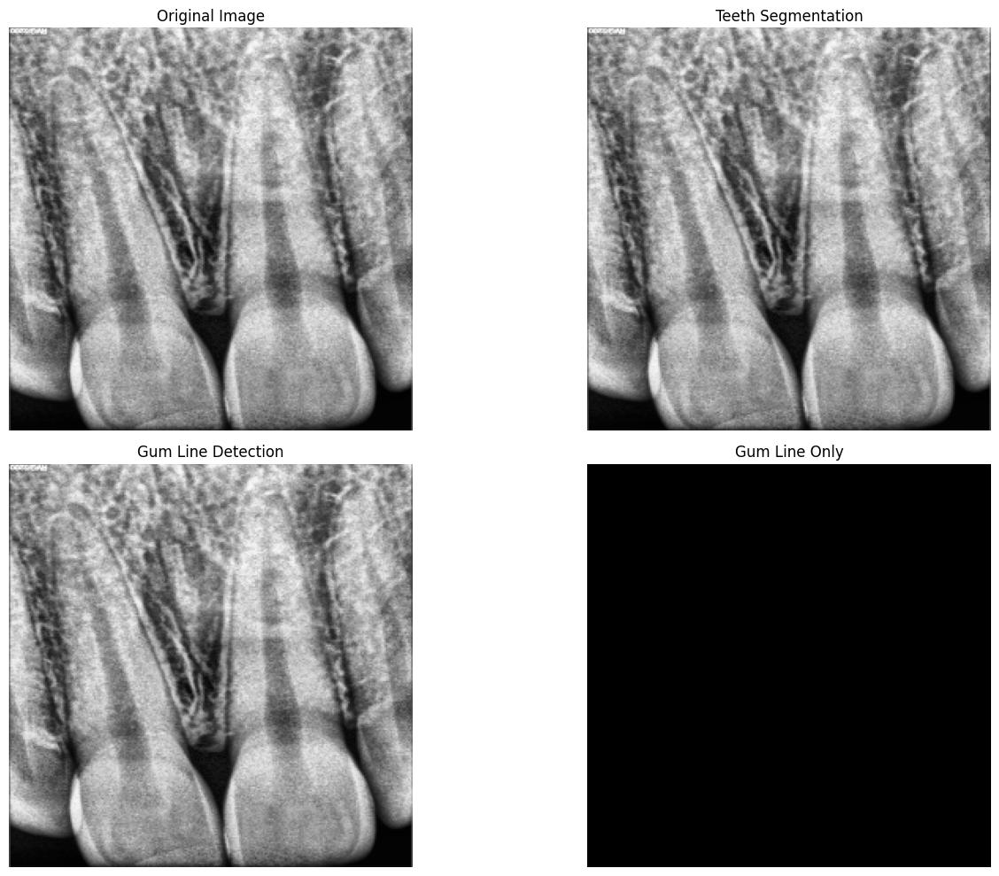

 18%|██████████████▋                                                                    | 9/51 [00:10<00:49,  1.18s/it]

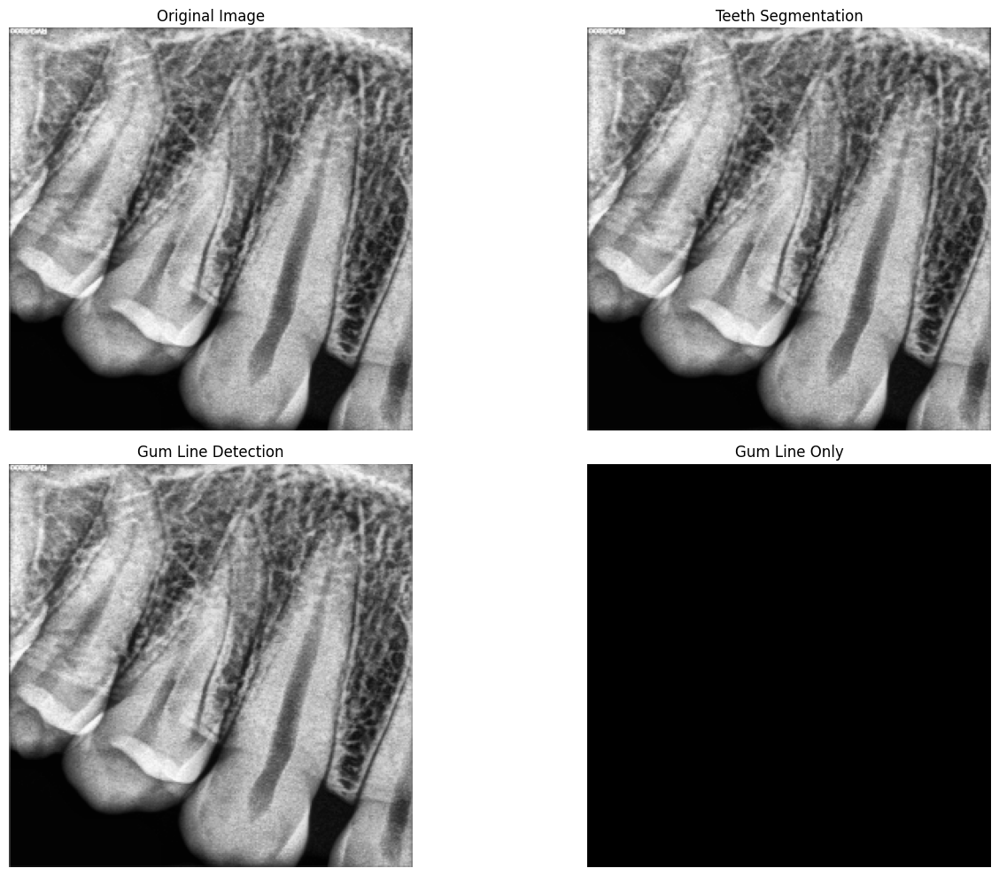

 20%|████████████████                                                                  | 10/51 [00:12<00:48,  1.18s/it]

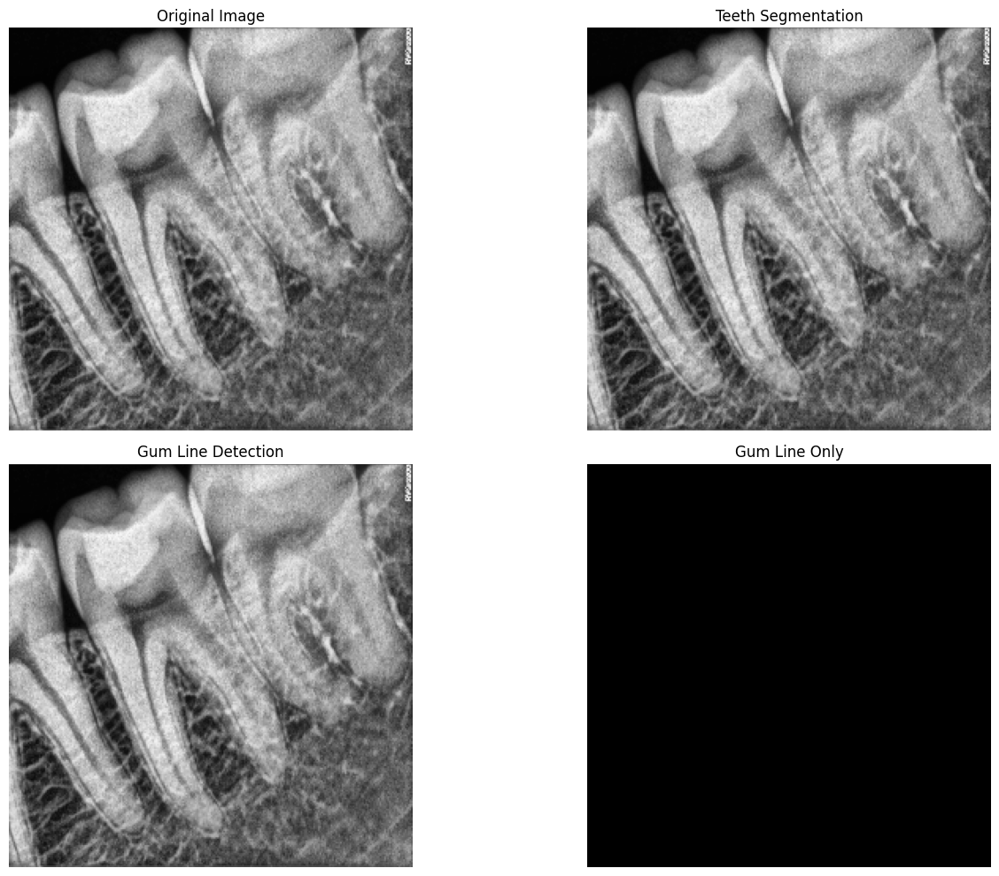

 22%|█████████████████▋                                                                | 11/51 [00:13<00:47,  1.18s/it]

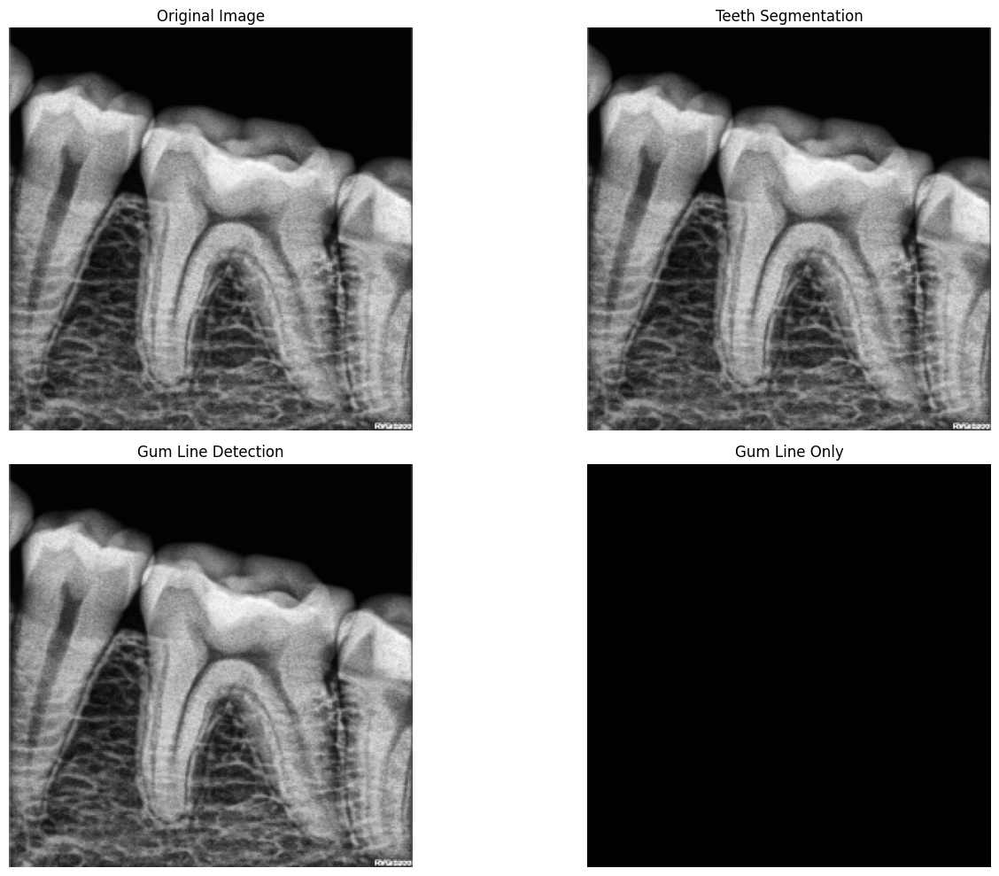

 24%|███████████████████▎                                                              | 12/51 [00:14<00:45,  1.17s/it]

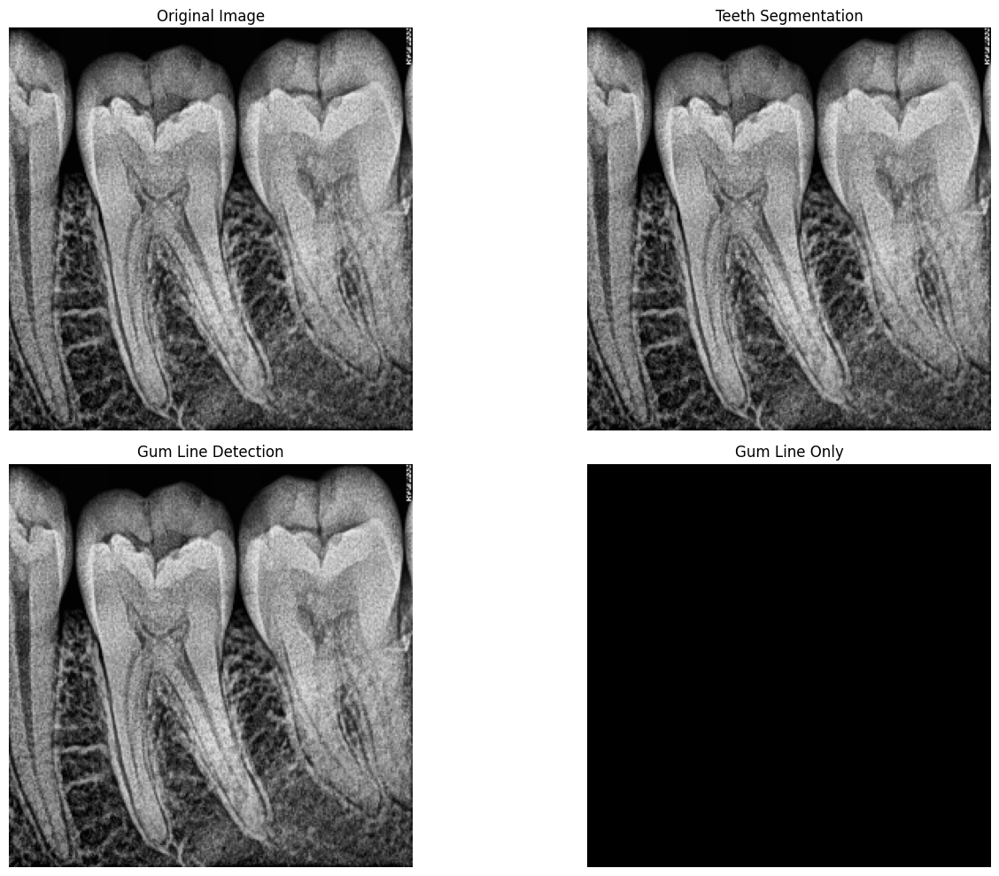

 25%|████████████████████▉                                                             | 13/51 [00:15<00:46,  1.22s/it]

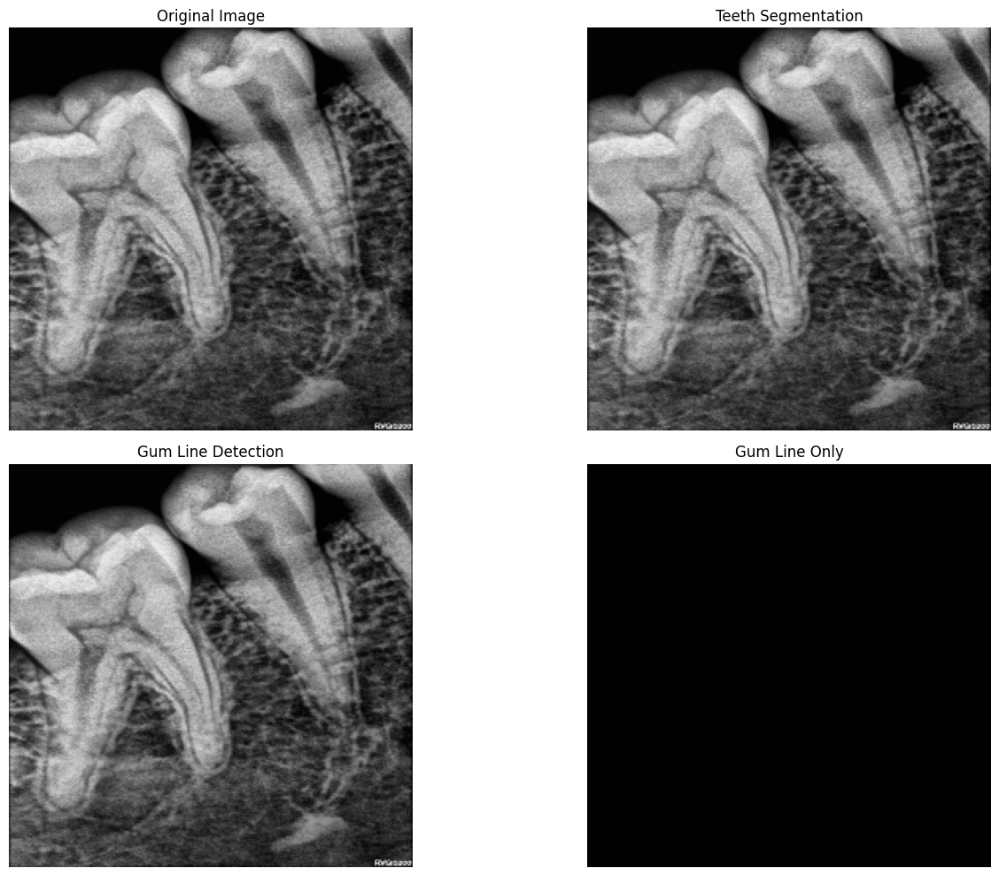

 27%|██████████████████████▌                                                           | 14/51 [00:16<00:44,  1.21s/it]

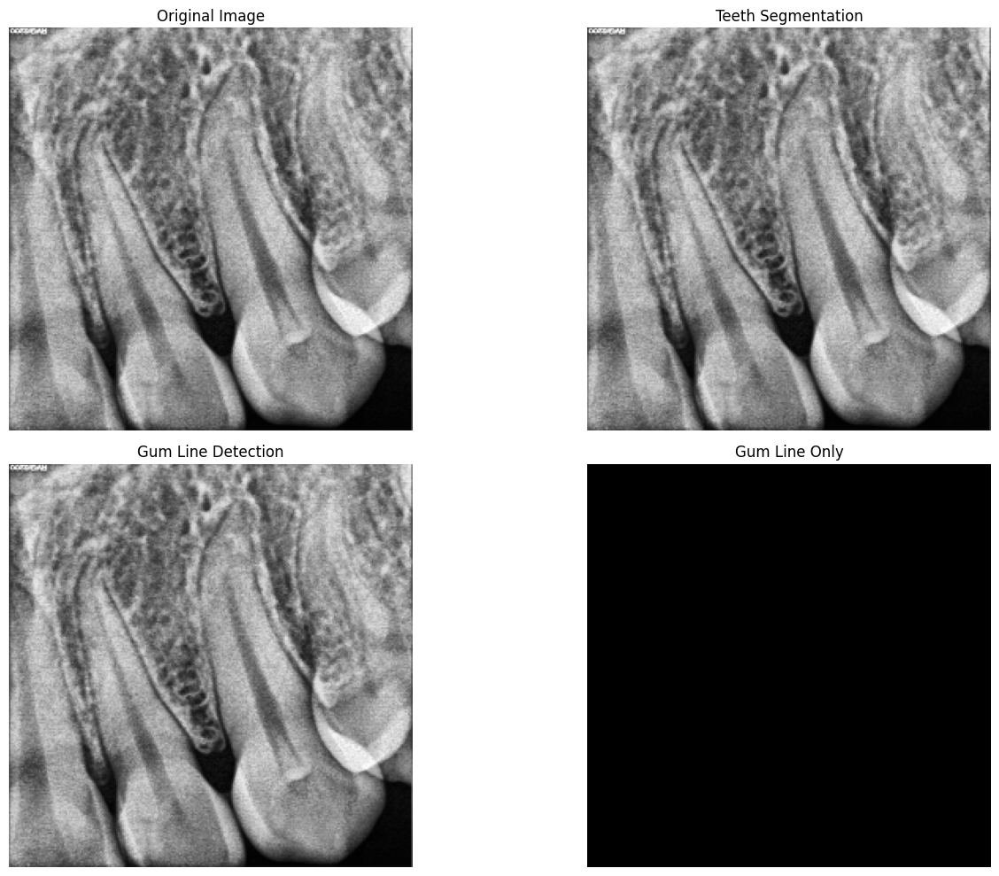

 29%|████████████████████████                                                          | 15/51 [00:18<00:43,  1.20s/it]

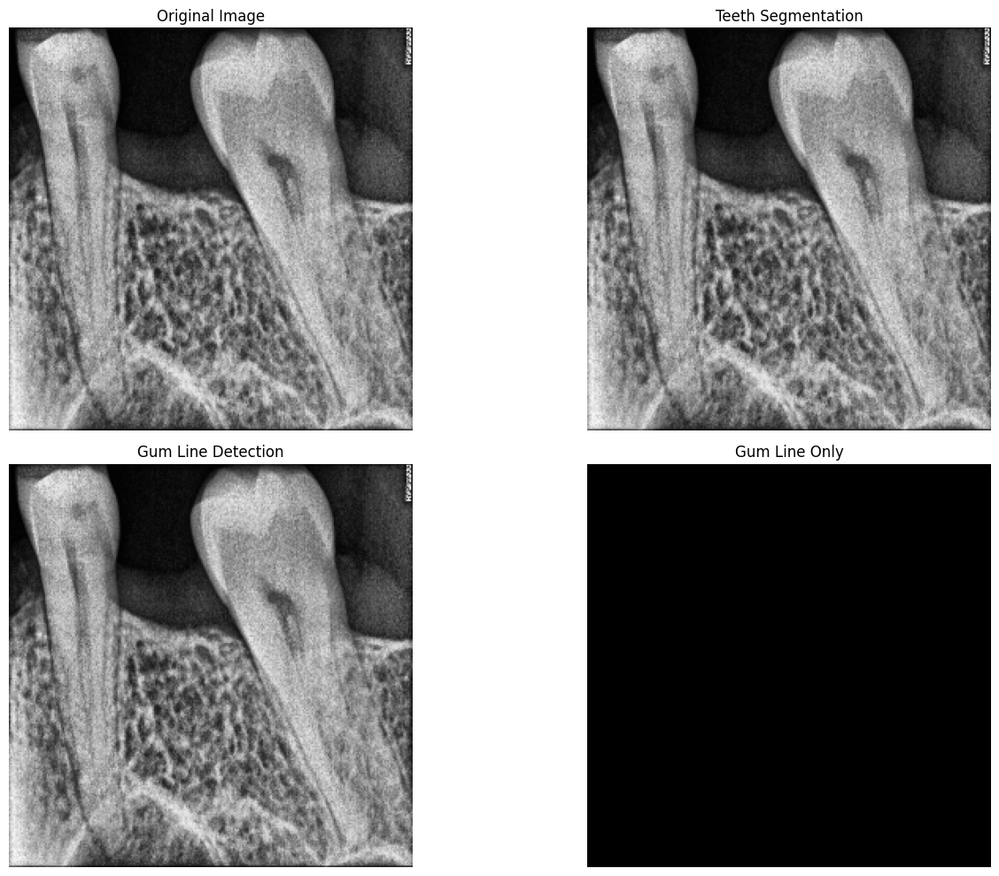

 31%|█████████████████████████▋                                                        | 16/51 [00:19<00:42,  1.21s/it]

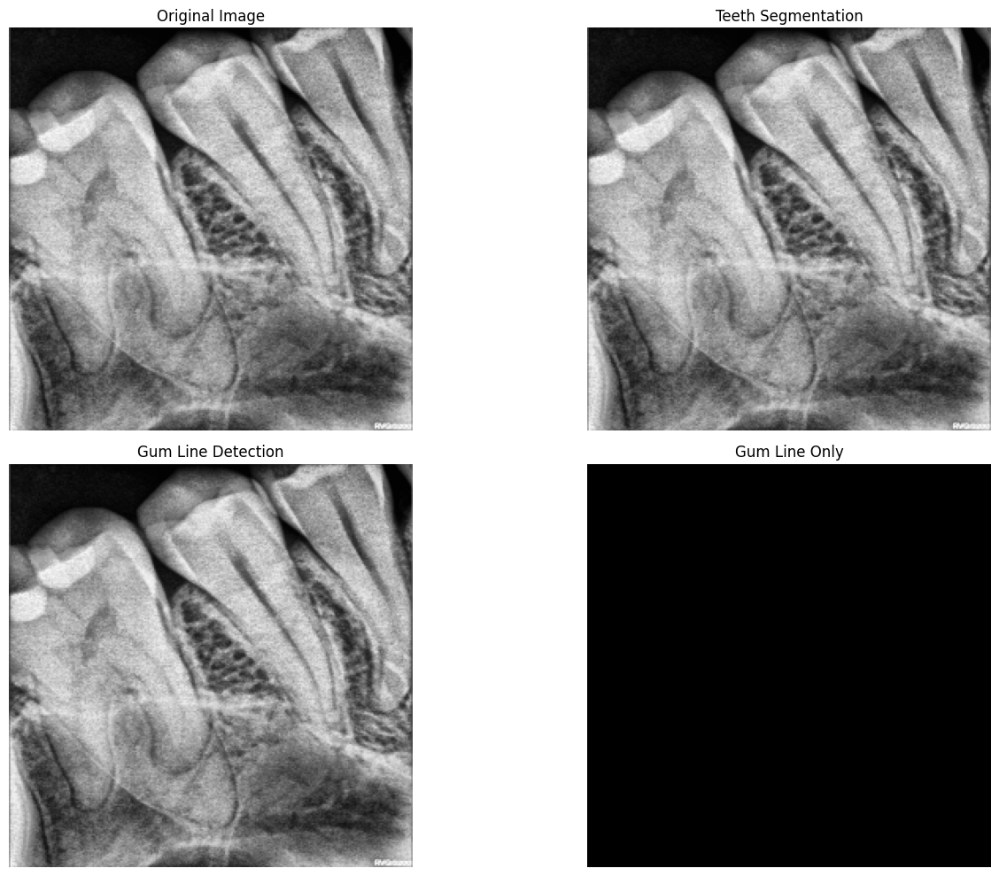

 33%|███████████████████████████▎                                                      | 17/51 [00:20<00:41,  1.22s/it]

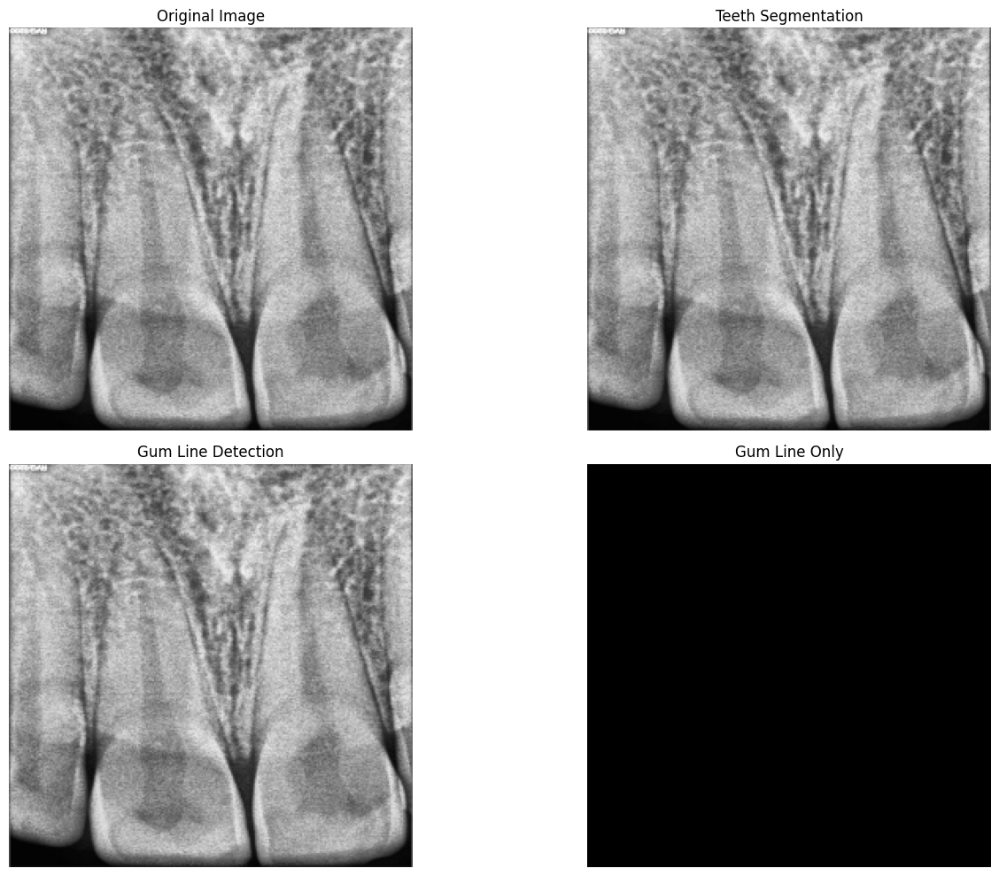

 35%|████████████████████████████▉                                                     | 18/51 [00:21<00:39,  1.20s/it]

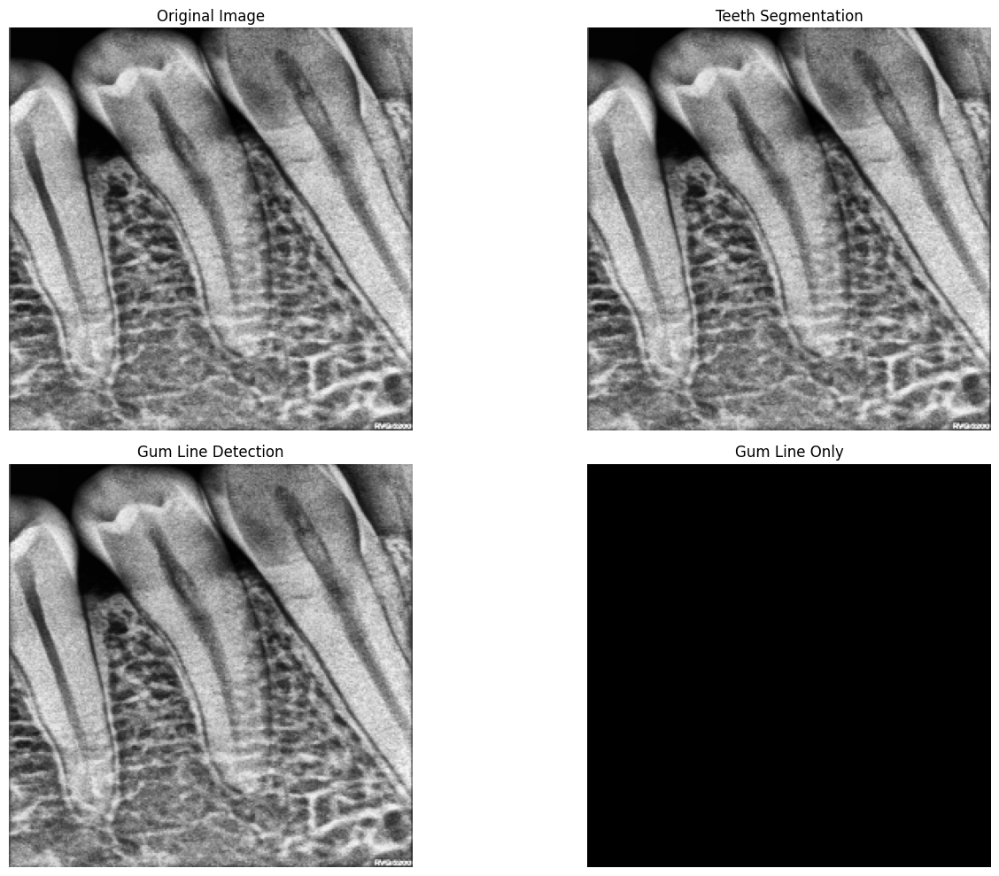

 37%|██████████████████████████████▌                                                   | 19/51 [00:22<00:38,  1.20s/it]

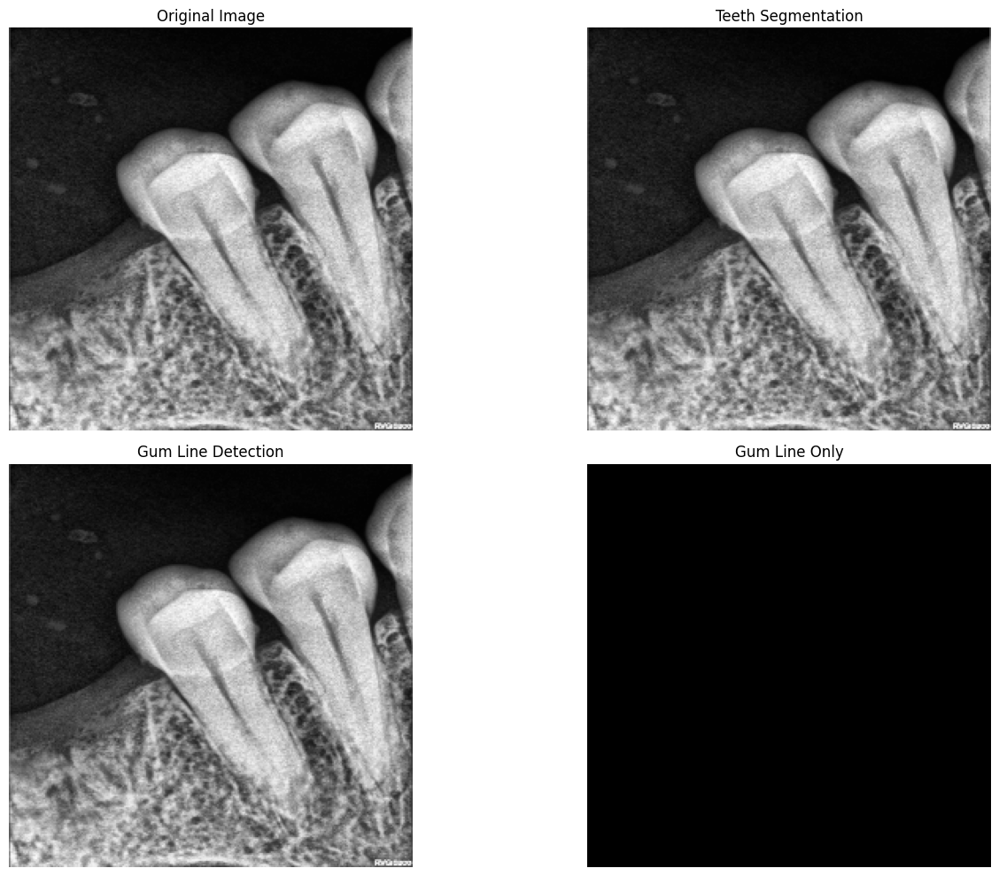

 39%|████████████████████████████████▏                                                 | 20/51 [00:24<00:36,  1.19s/it]

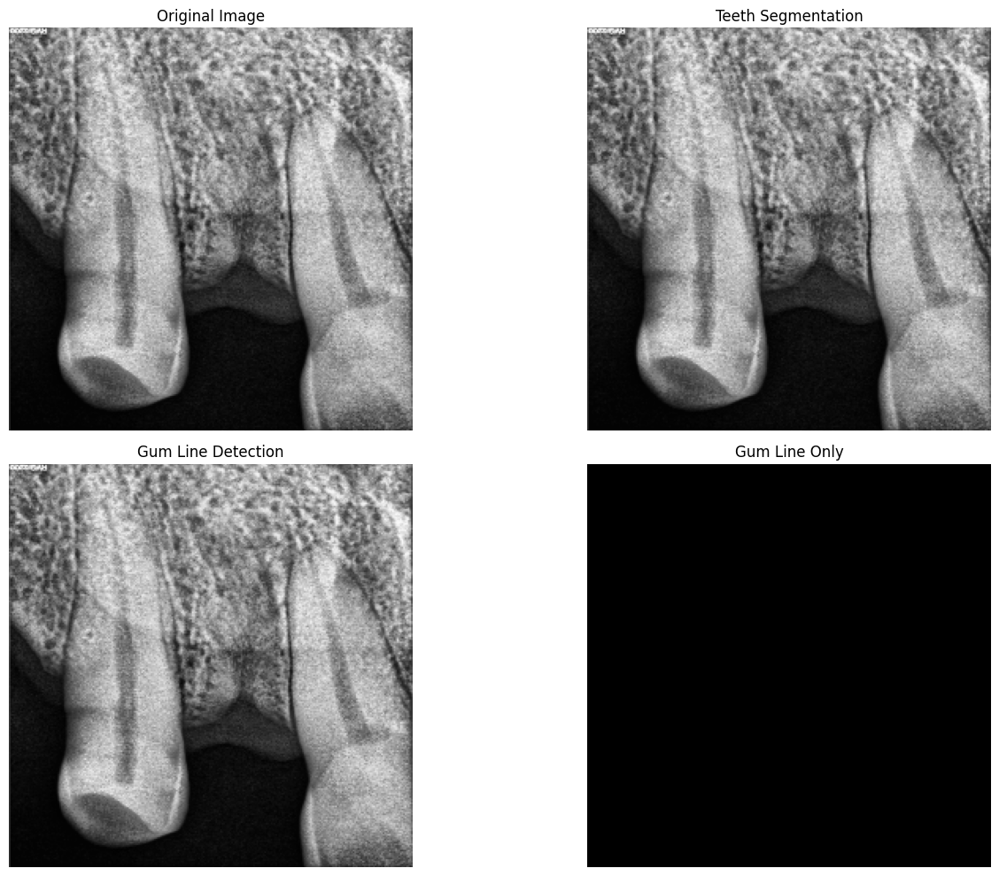

 41%|█████████████████████████████████▊                                                | 21/51 [00:25<00:36,  1.23s/it]

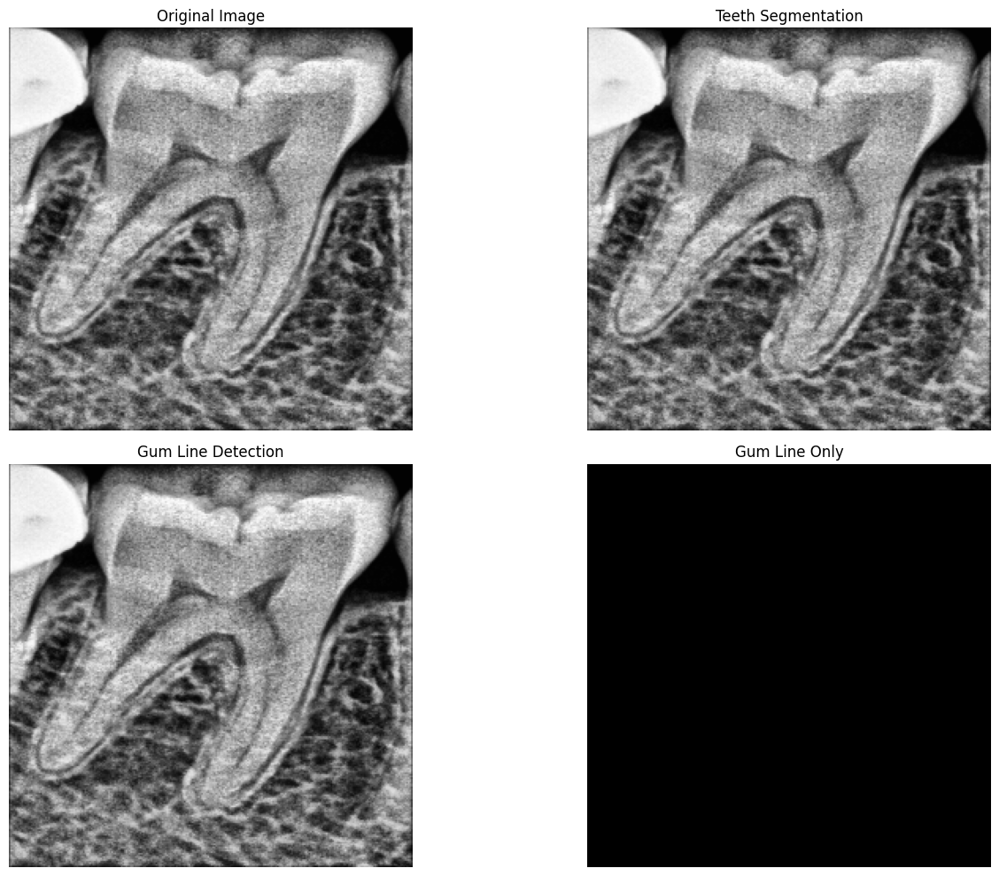

 43%|███████████████████████████████████▎                                              | 22/51 [00:26<00:35,  1.21s/it]

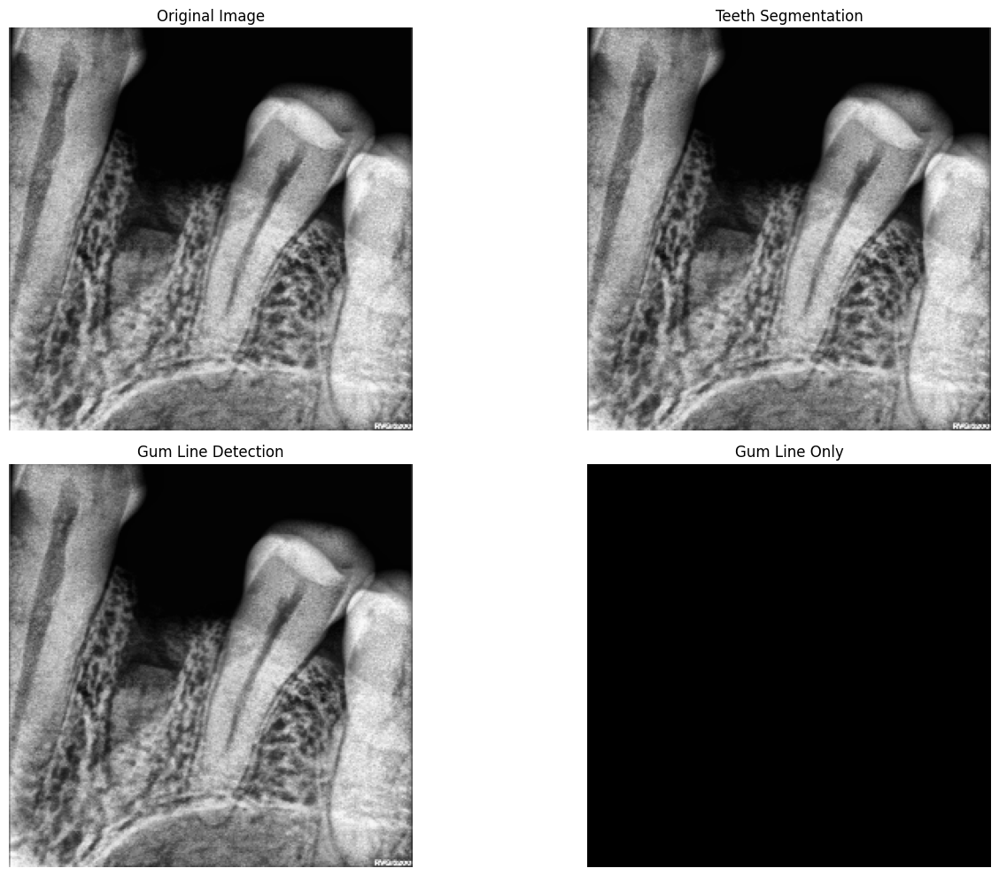

 45%|████████████████████████████████████▉                                             | 23/51 [00:27<00:33,  1.19s/it]

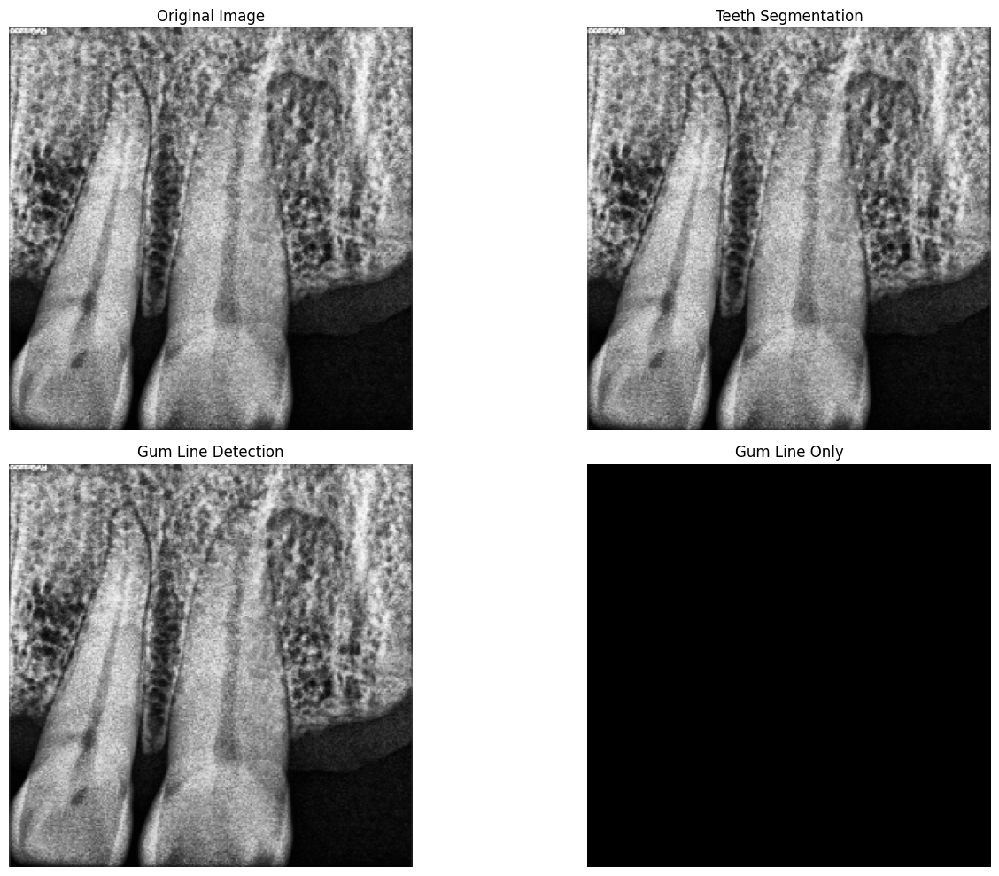

 47%|██████████████████████████████████████▌                                           | 24/51 [00:28<00:32,  1.19s/it]

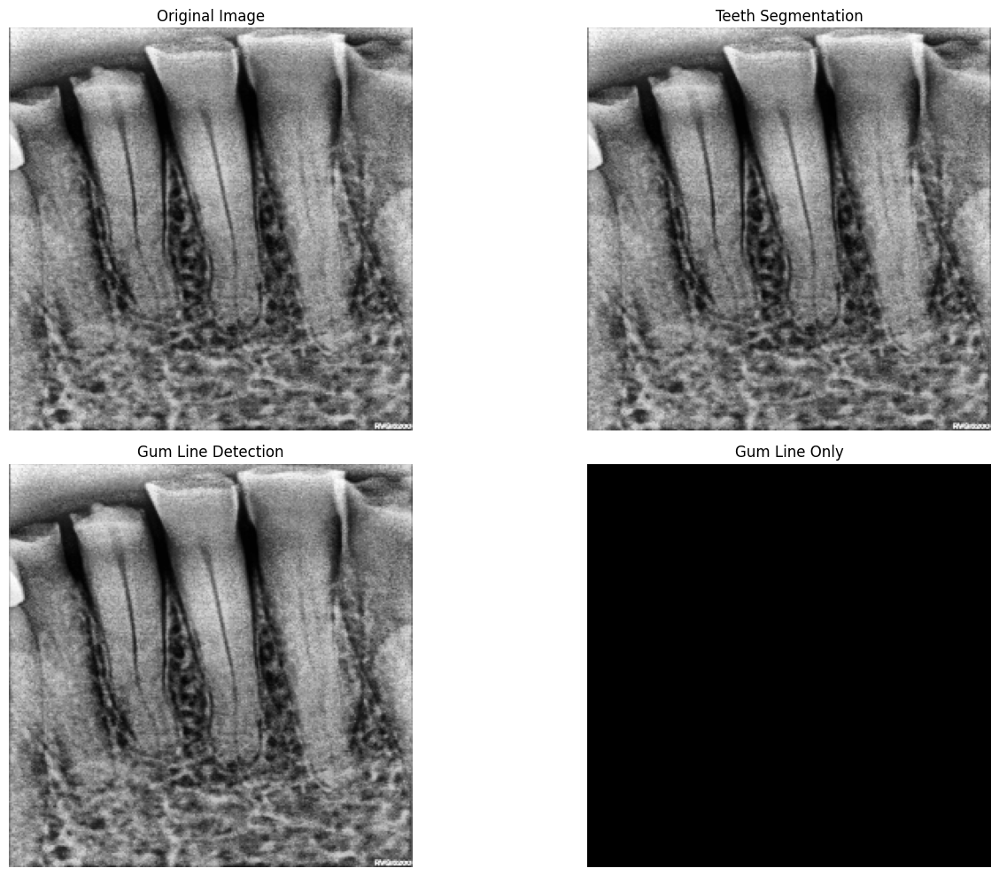

 49%|████████████████████████████████████████▏                                         | 25/51 [00:30<00:30,  1.18s/it]

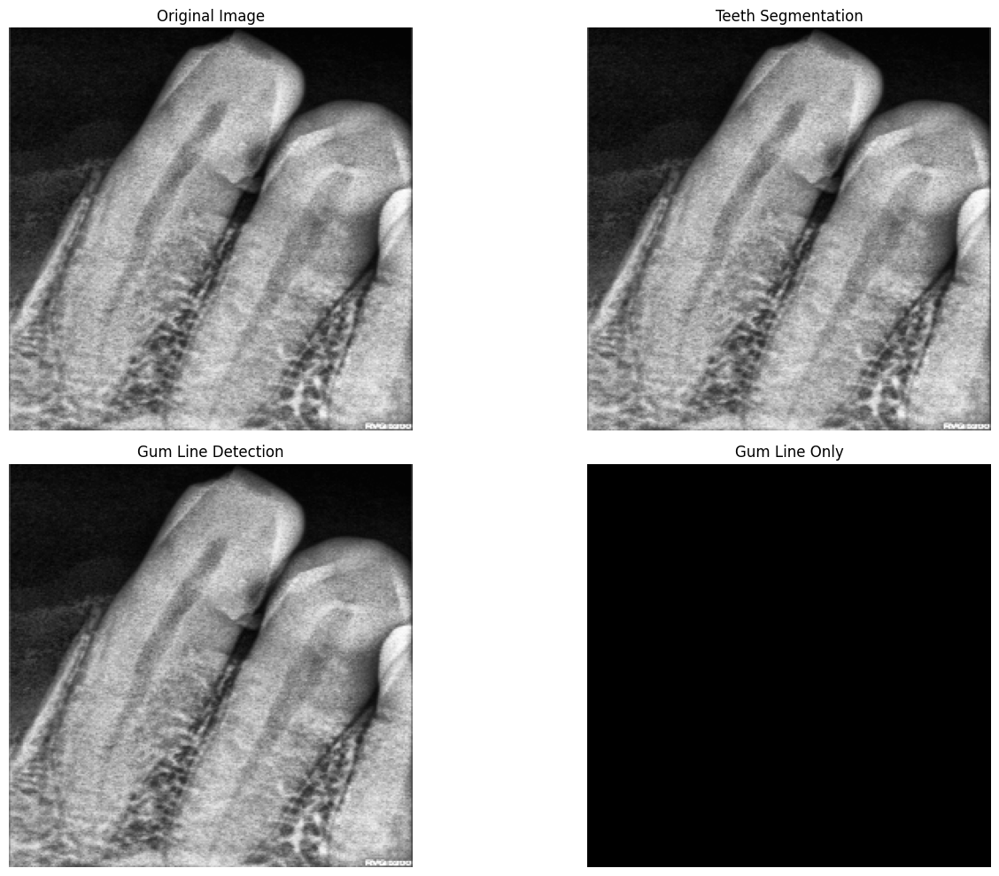

 51%|█████████████████████████████████████████▊                                        | 26/51 [00:31<00:29,  1.17s/it]

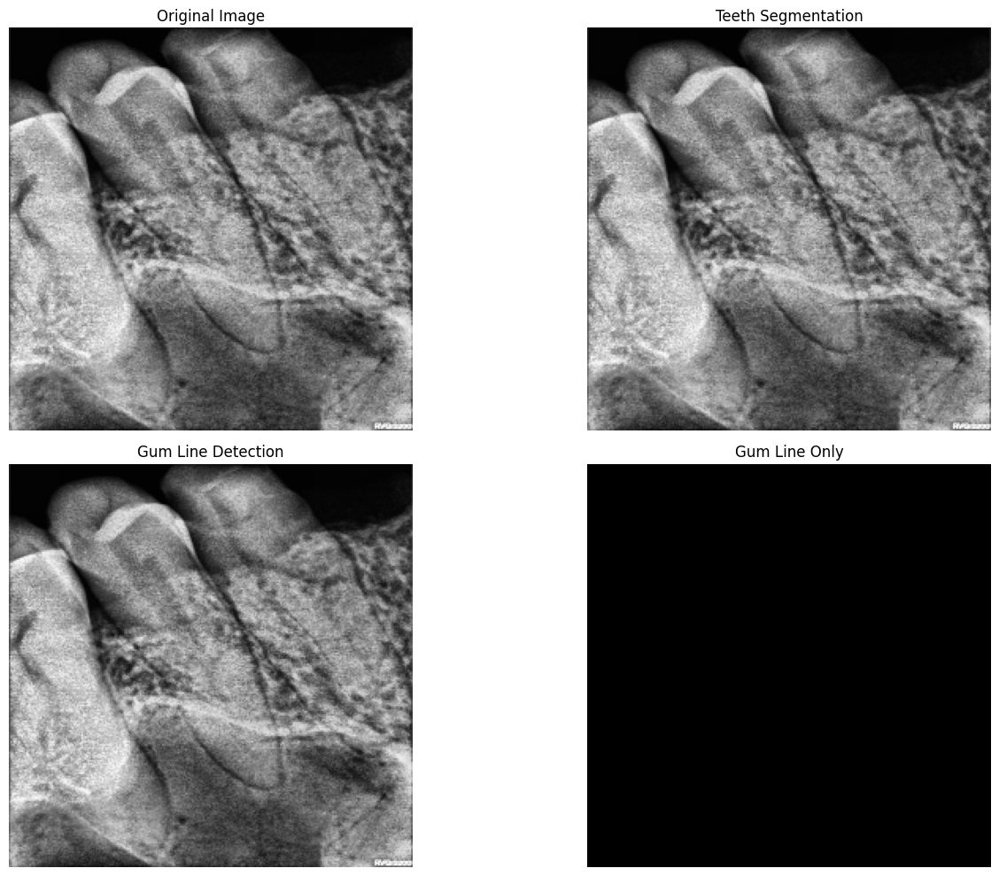

 53%|███████████████████████████████████████████▍                                      | 27/51 [00:32<00:28,  1.17s/it]

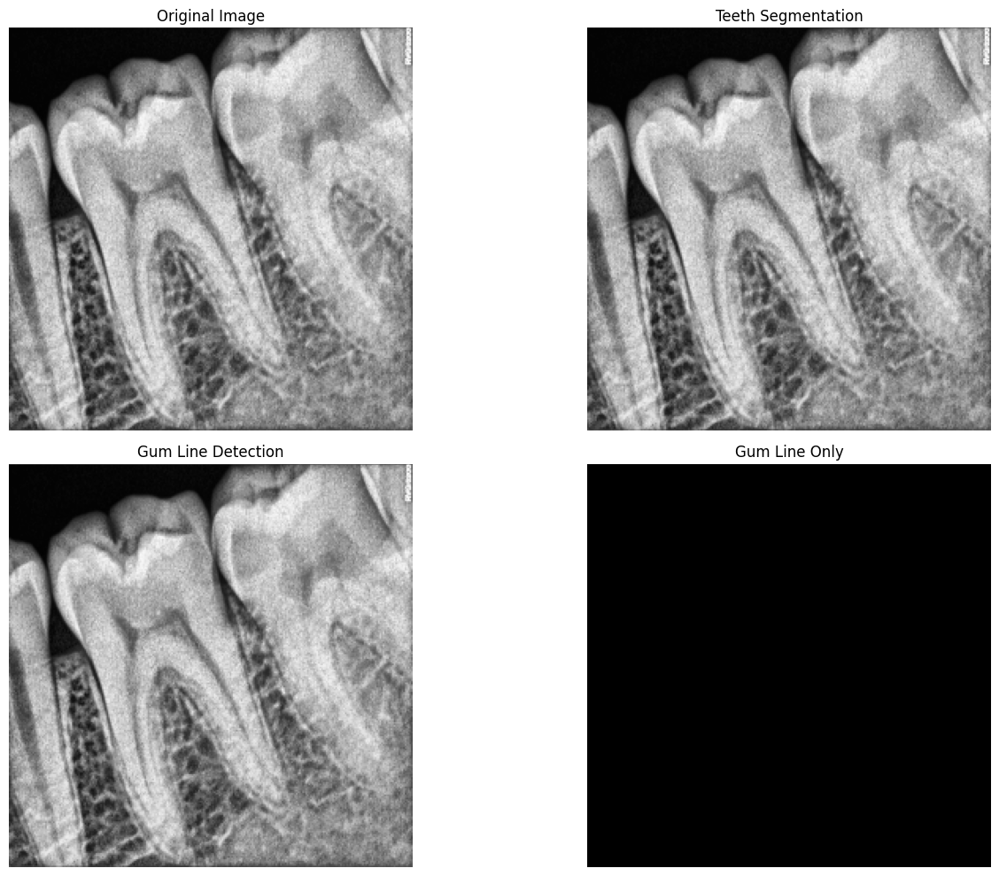

 55%|█████████████████████████████████████████████                                     | 28/51 [00:33<00:27,  1.18s/it]

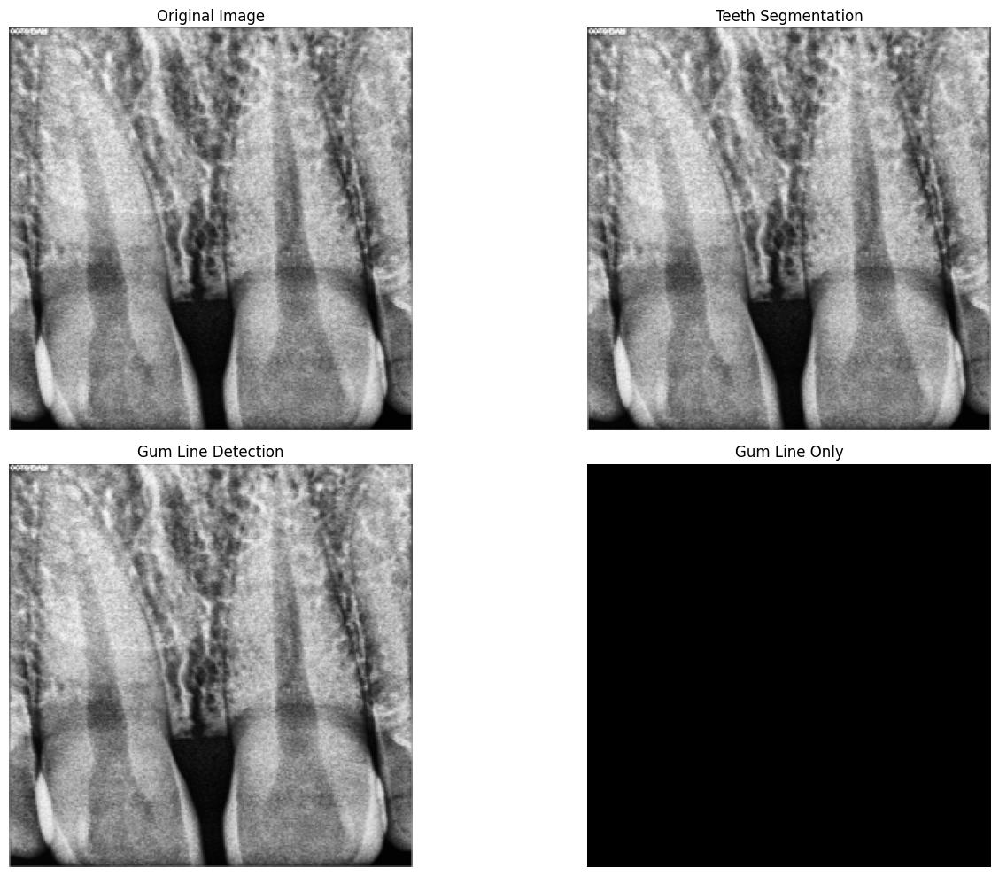

 57%|██████████████████████████████████████████████▋                                   | 29/51 [00:34<00:26,  1.22s/it]

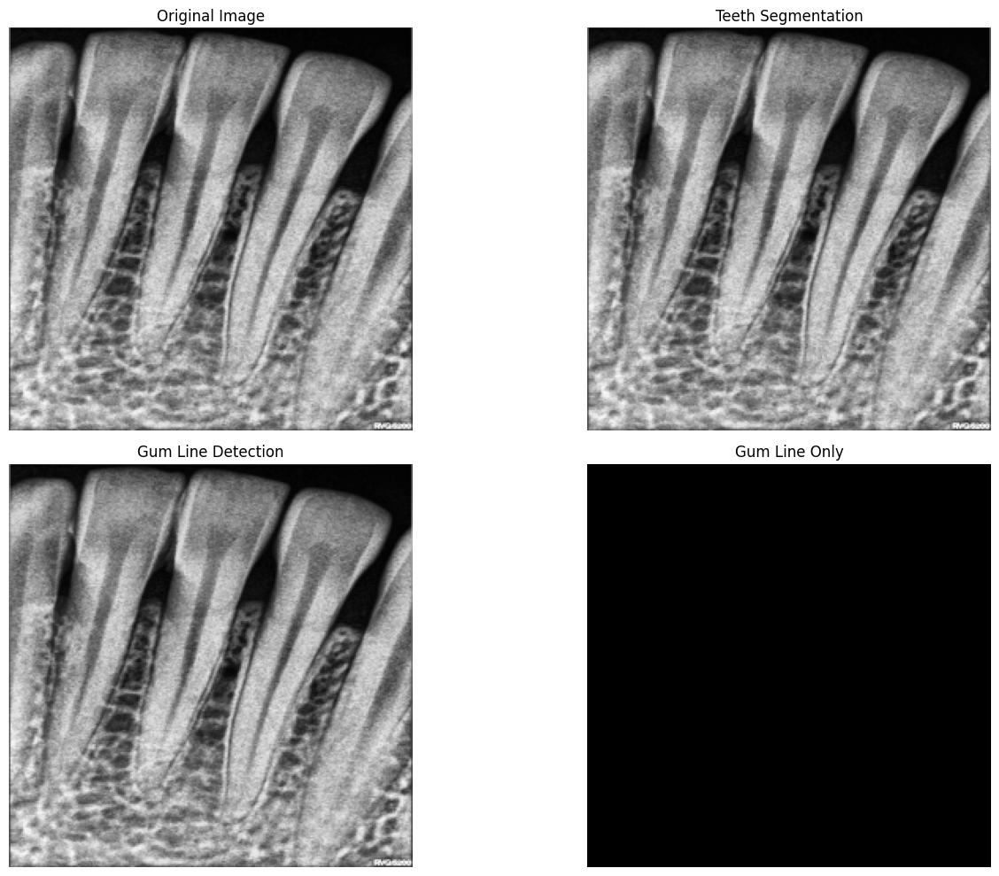

 59%|████████████████████████████████████████████████▏                                 | 30/51 [00:36<00:25,  1.20s/it]

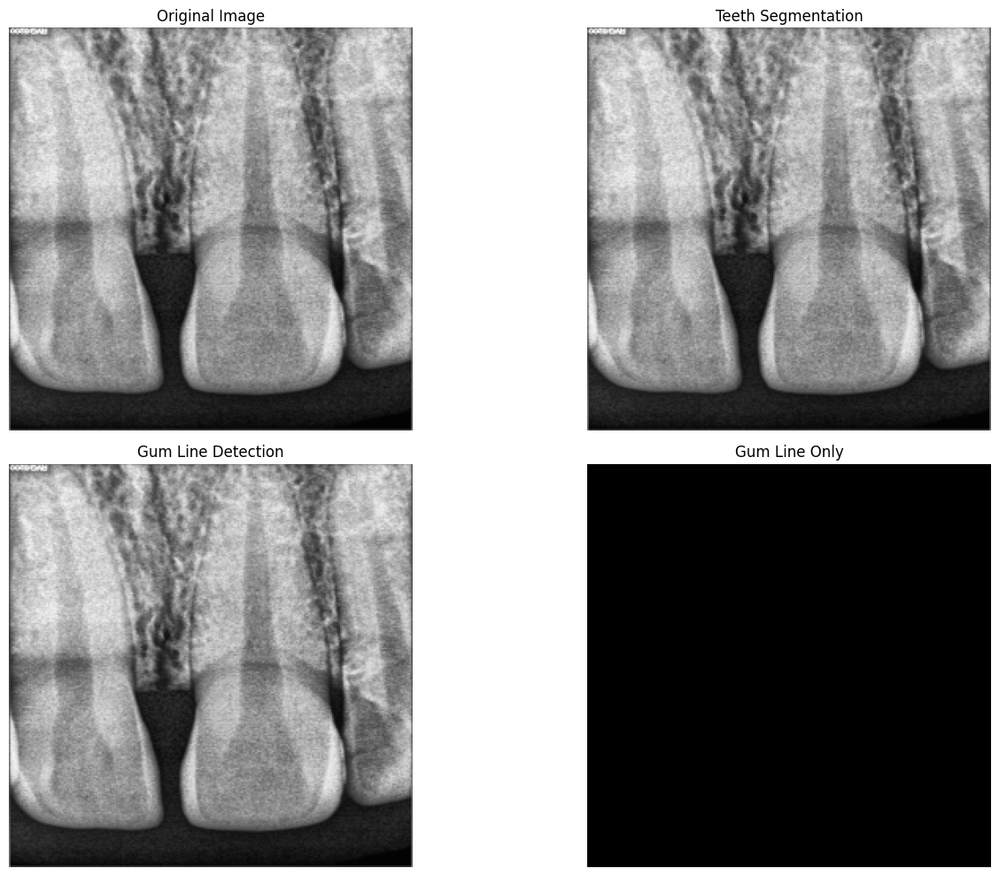

 61%|█████████████████████████████████████████████████▊                                | 31/51 [00:37<00:23,  1.19s/it]

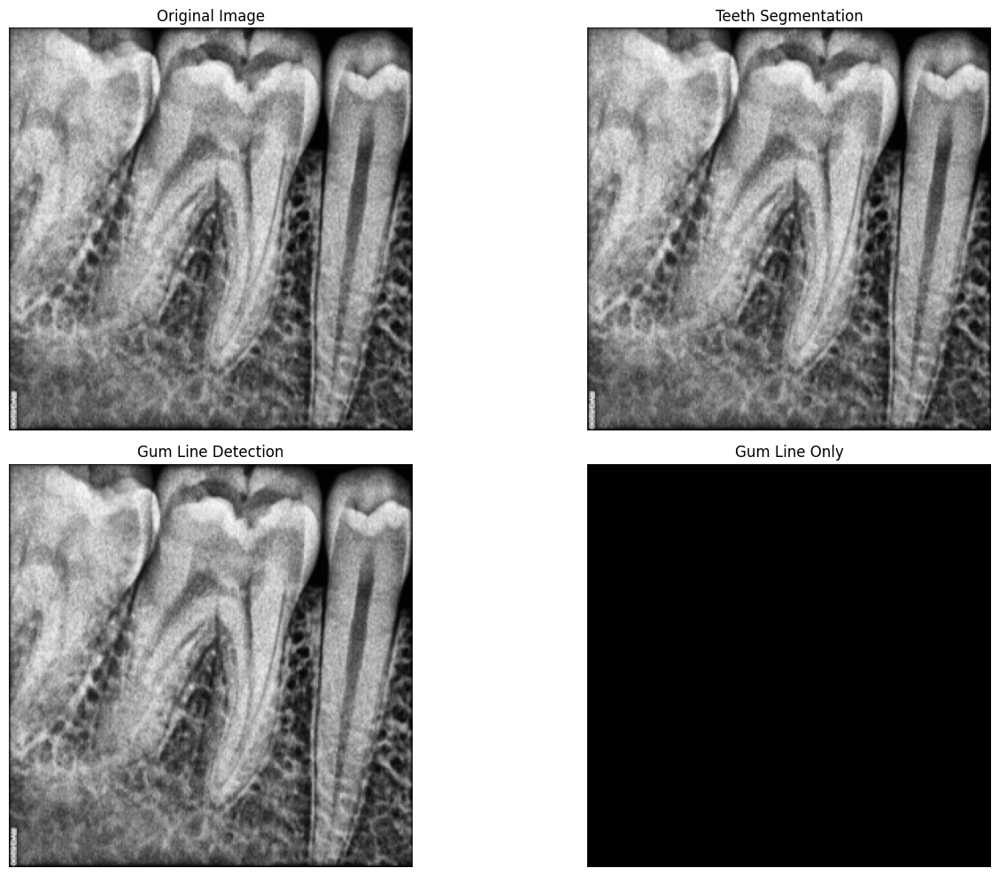

 63%|███████████████████████████████████████████████████▍                              | 32/51 [00:38<00:22,  1.18s/it]

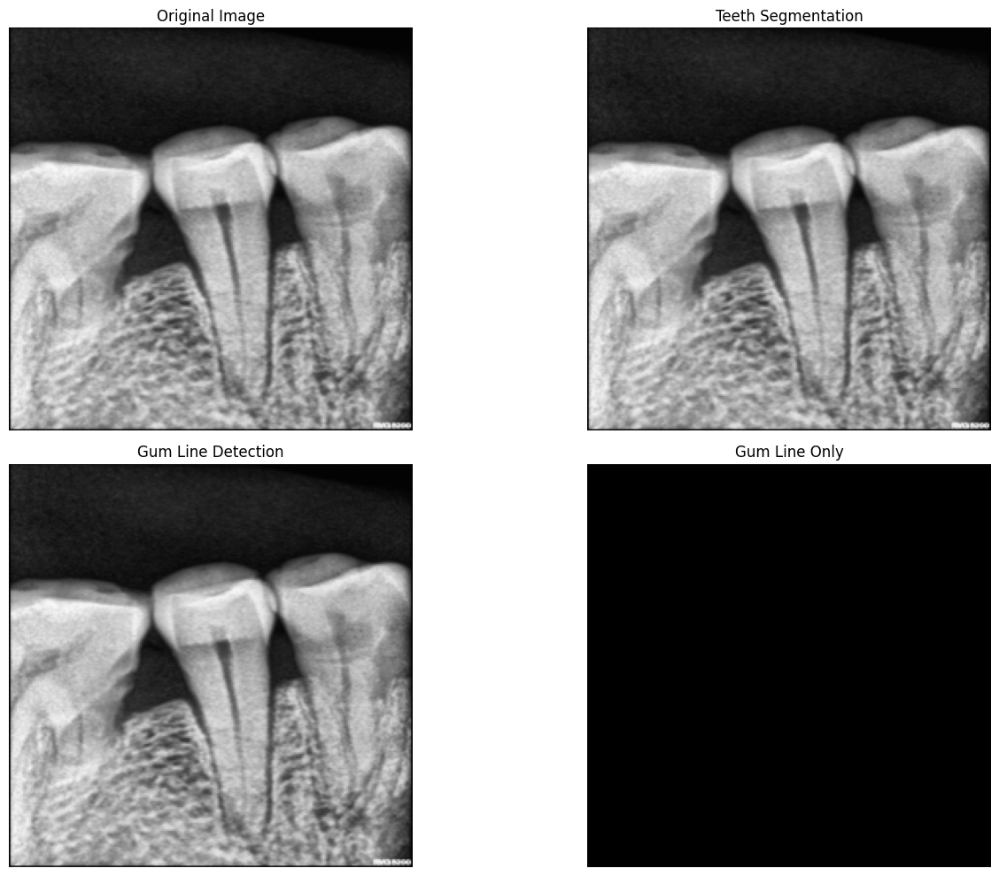

 65%|█████████████████████████████████████████████████████                             | 33/51 [00:39<00:20,  1.16s/it]

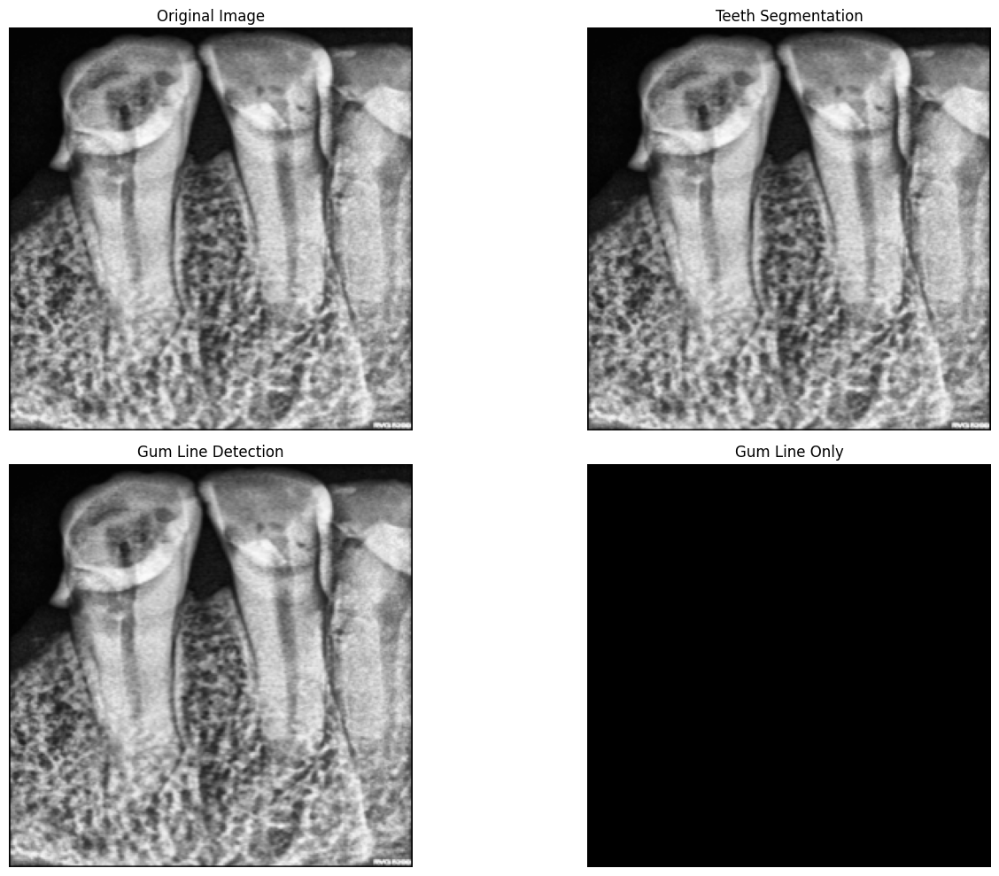

 67%|██████████████████████████████████████████████████████▋                           | 34/51 [00:40<00:19,  1.16s/it]

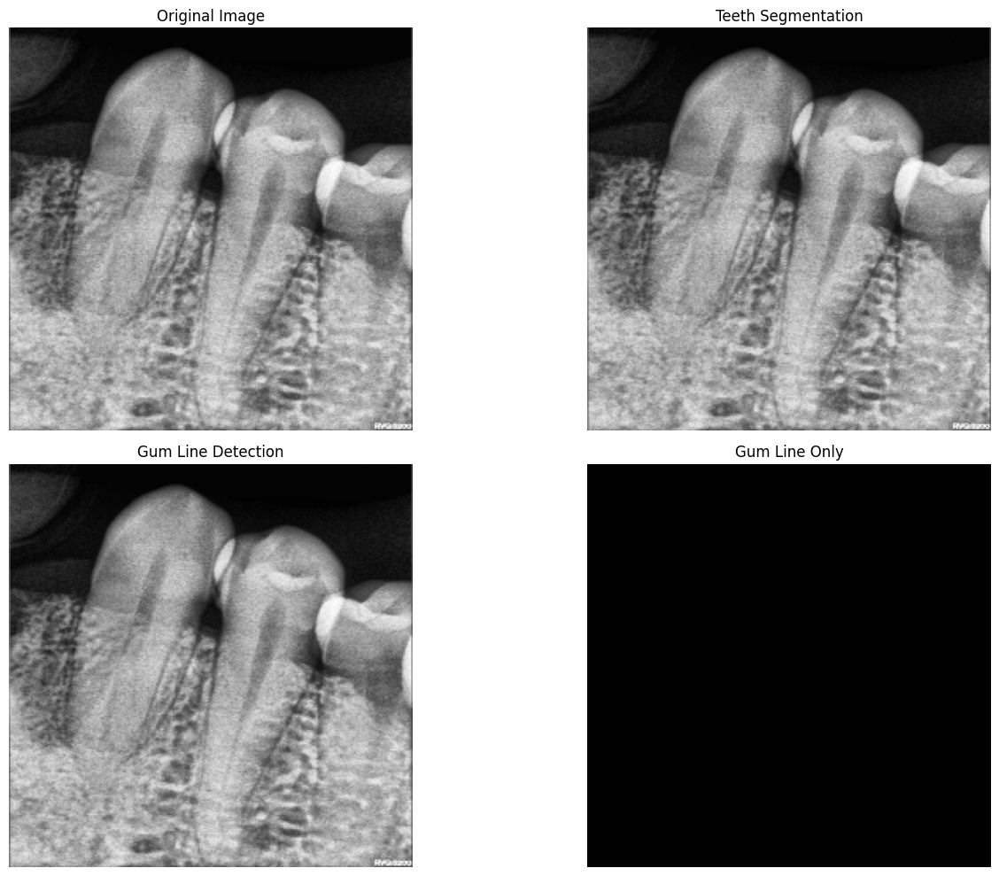

 69%|████████████████████████████████████████████████████████▎                         | 35/51 [00:41<00:18,  1.16s/it]

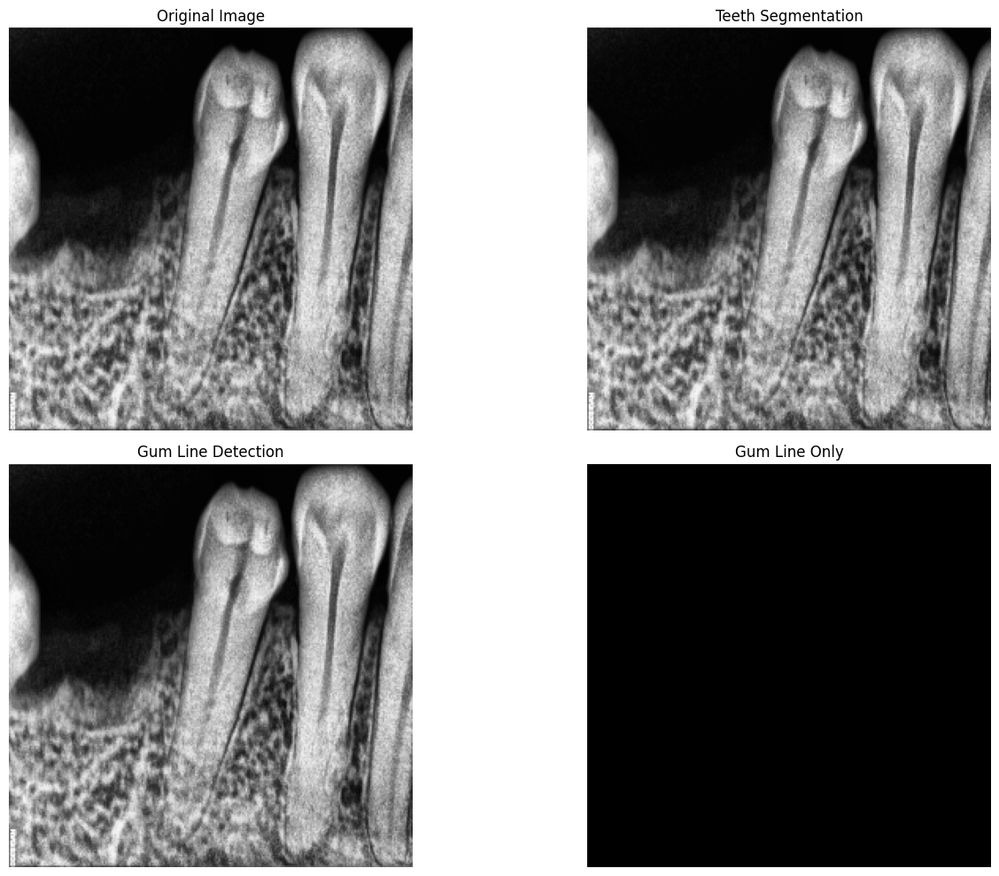

 71%|█████████████████████████████████████████████████████████▉                        | 36/51 [00:42<00:17,  1.16s/it]

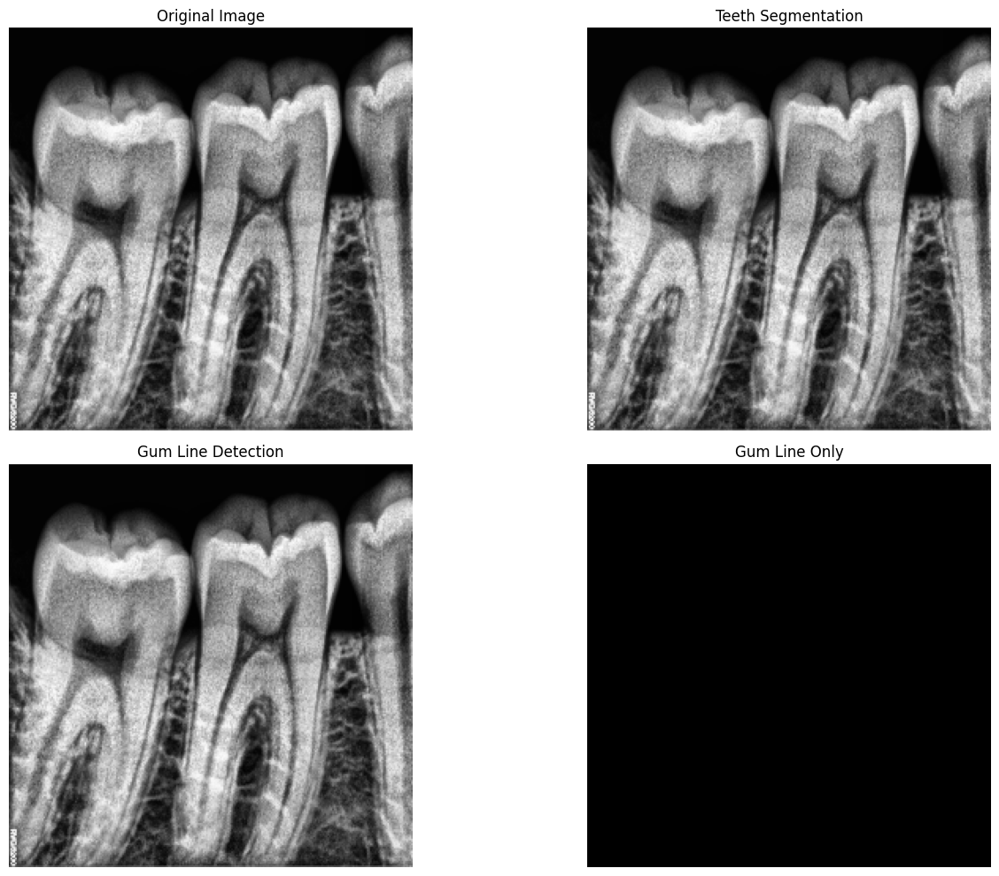

 73%|███████████████████████████████████████████████████████████▍                      | 37/51 [00:44<00:16,  1.16s/it]

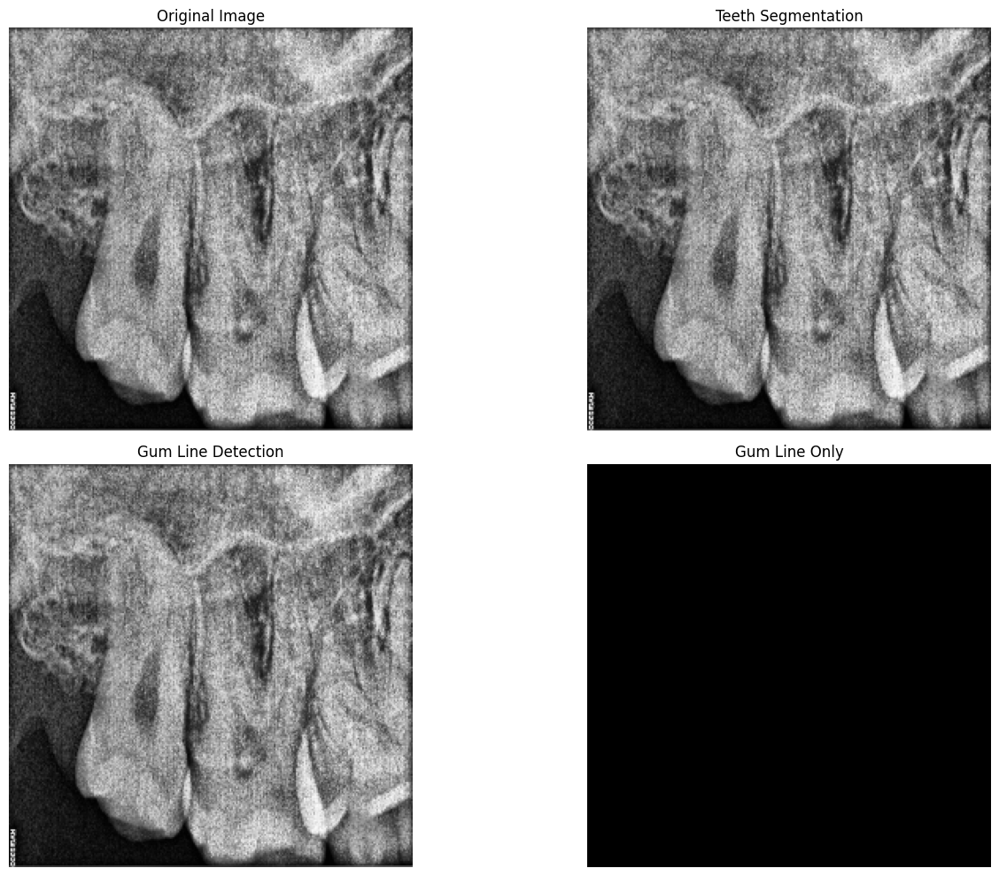

 75%|█████████████████████████████████████████████████████████████                     | 38/51 [00:45<00:15,  1.23s/it]

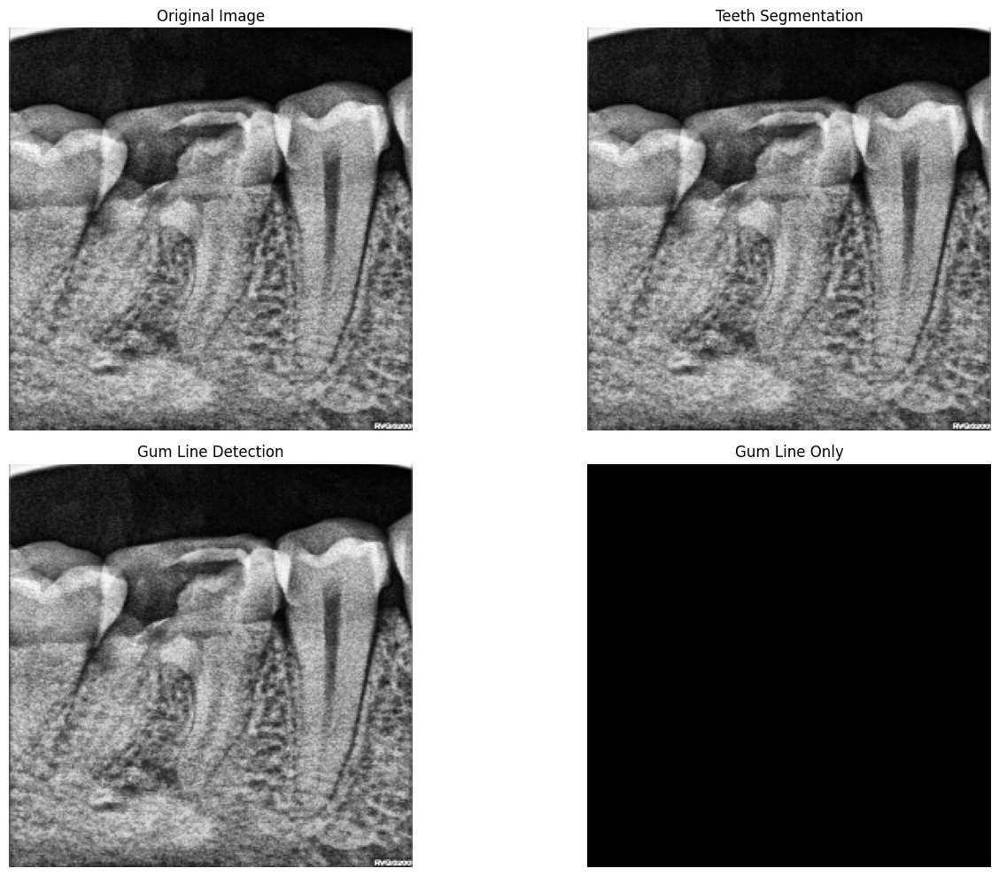

 76%|██████████████████████████████████████████████████████████████▋                   | 39/51 [00:46<00:14,  1.22s/it]

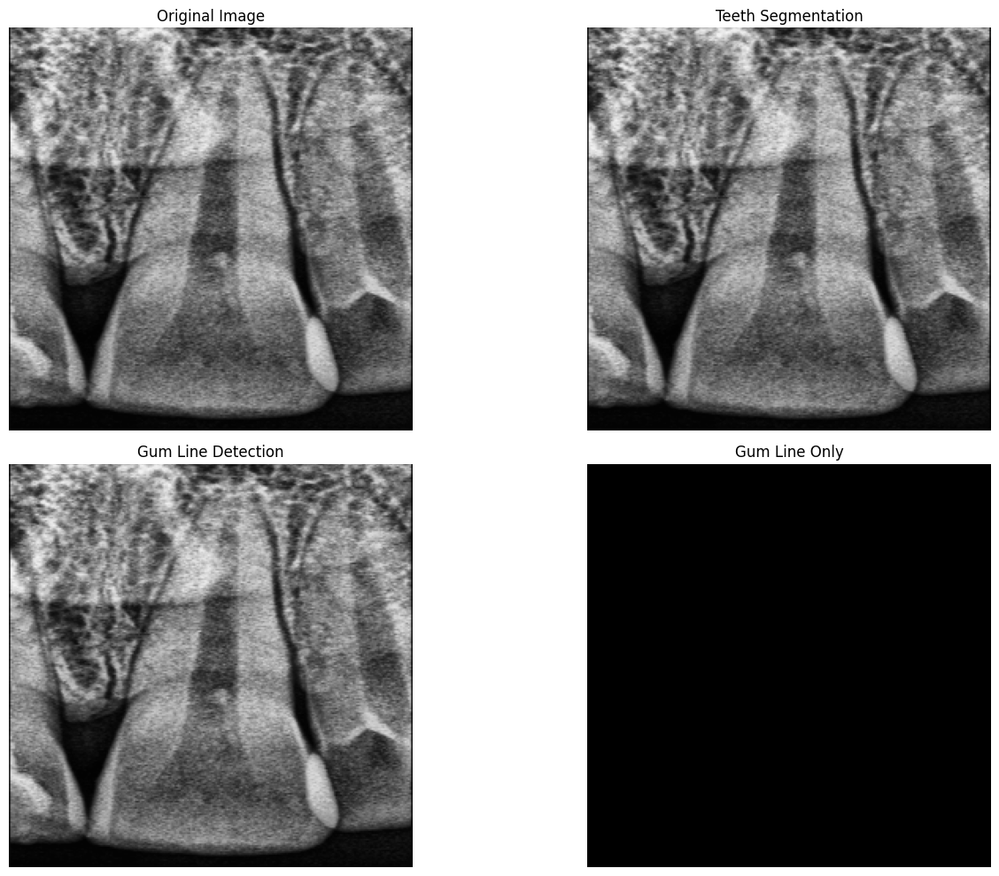

 78%|████████████████████████████████████████████████████████████████▎                 | 40/51 [00:47<00:13,  1.20s/it]

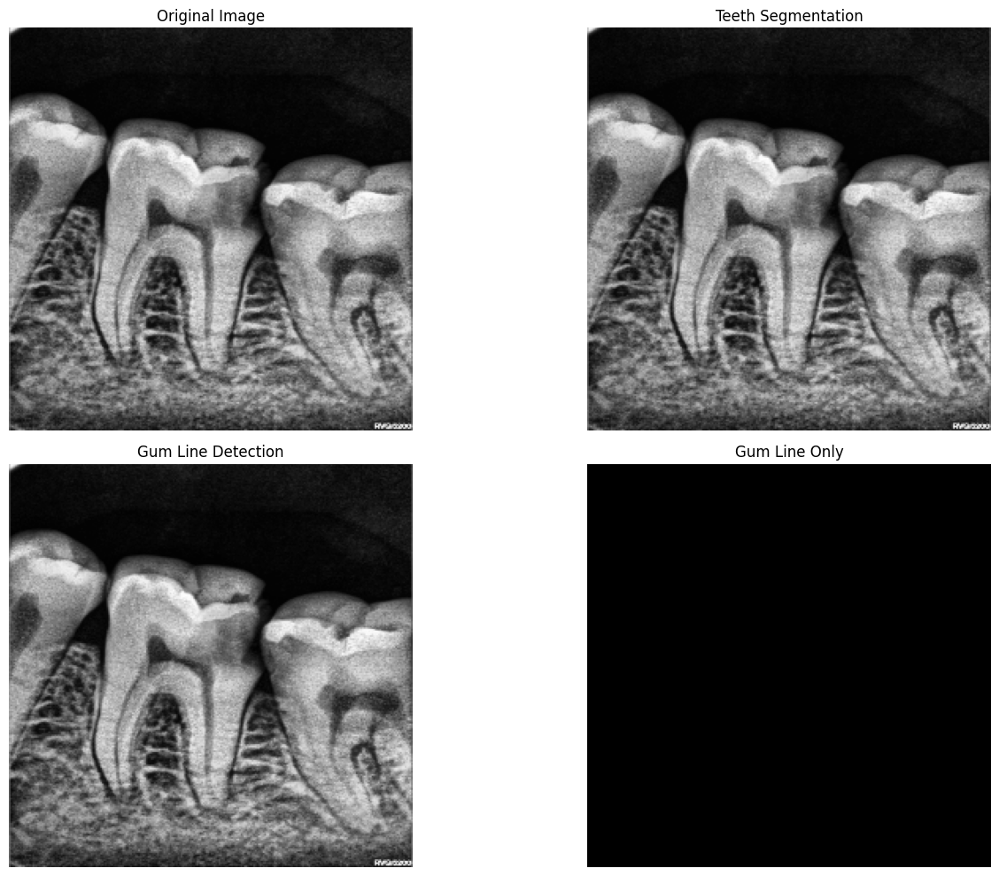

 80%|█████████████████████████████████████████████████████████████████▉                | 41/51 [00:48<00:11,  1.18s/it]

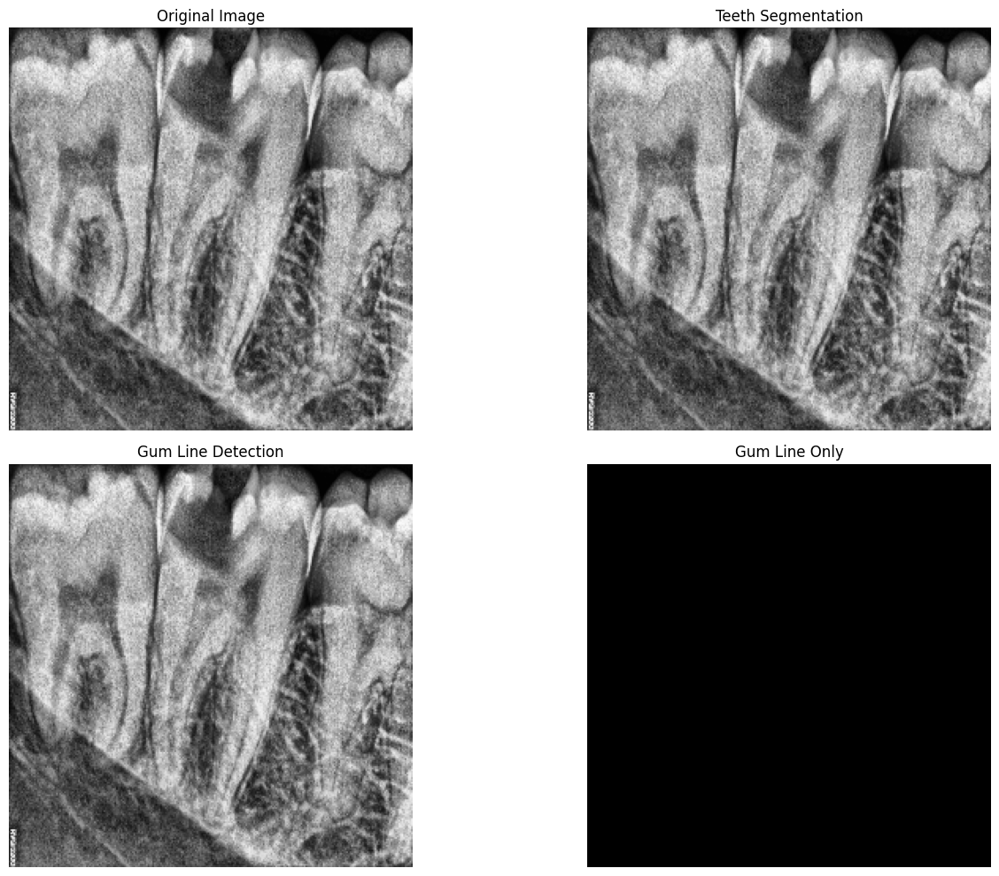

 82%|███████████████████████████████████████████████████████████████████▌              | 42/51 [00:50<00:10,  1.17s/it]

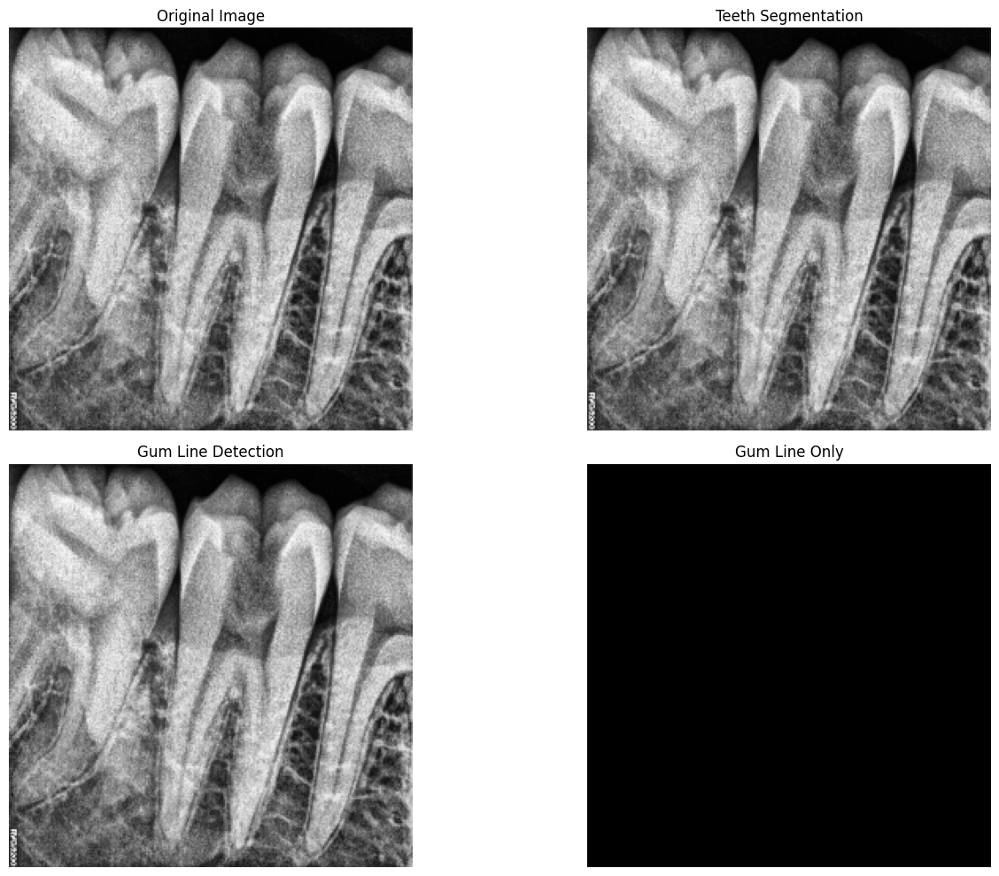

 84%|█████████████████████████████████████████████████████████████████████▏            | 43/51 [00:51<00:09,  1.18s/it]

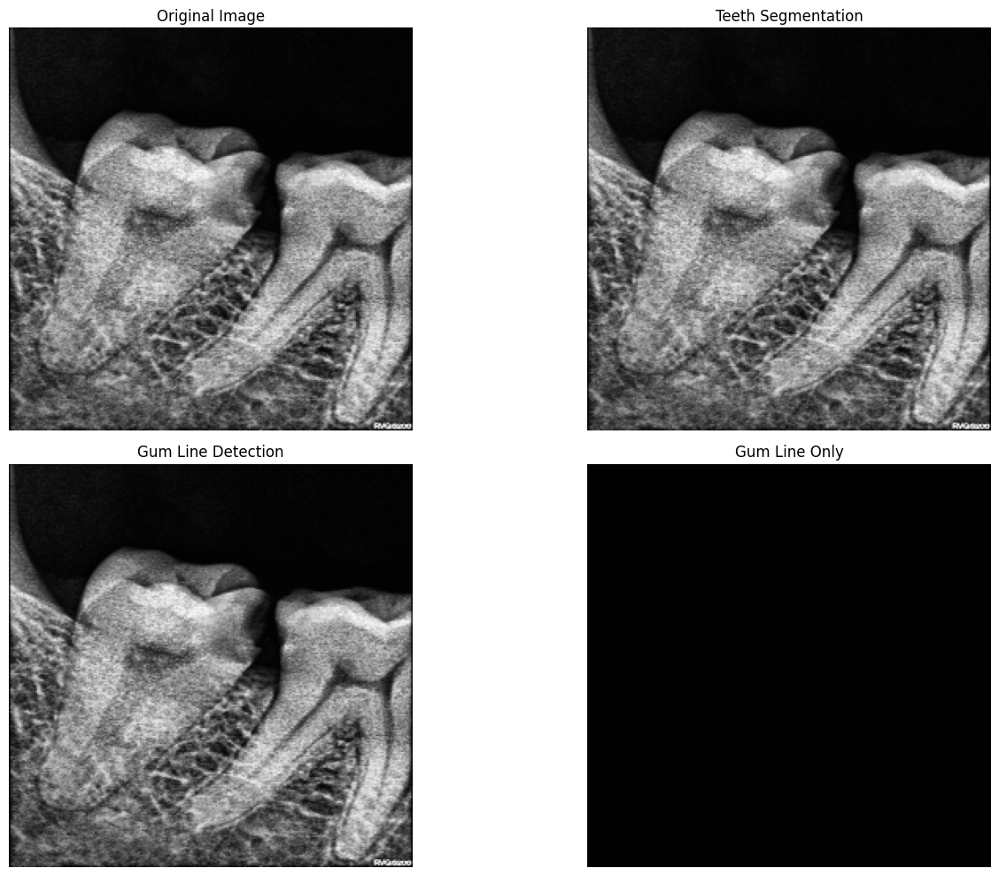

 86%|██████████████████████████████████████████████████████████████████████▋           | 44/51 [00:52<00:08,  1.18s/it]

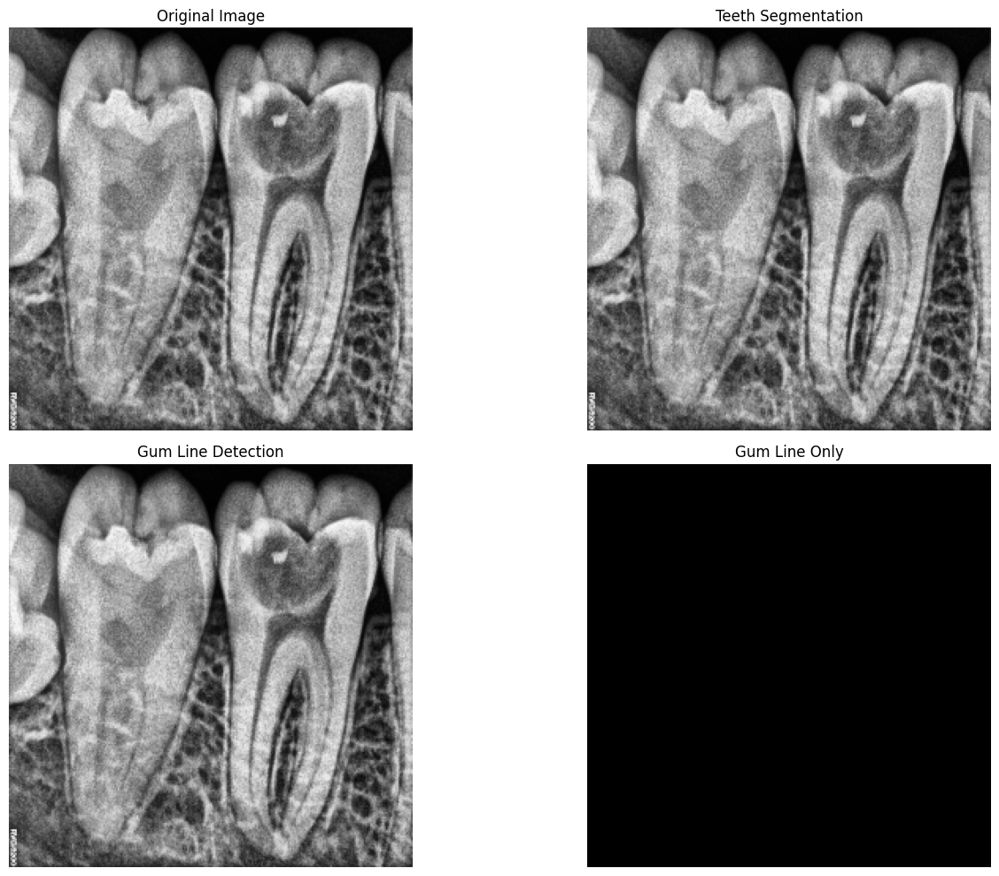

 88%|████████████████████████████████████████████████████████████████████████▎         | 45/51 [00:53<00:07,  1.18s/it]

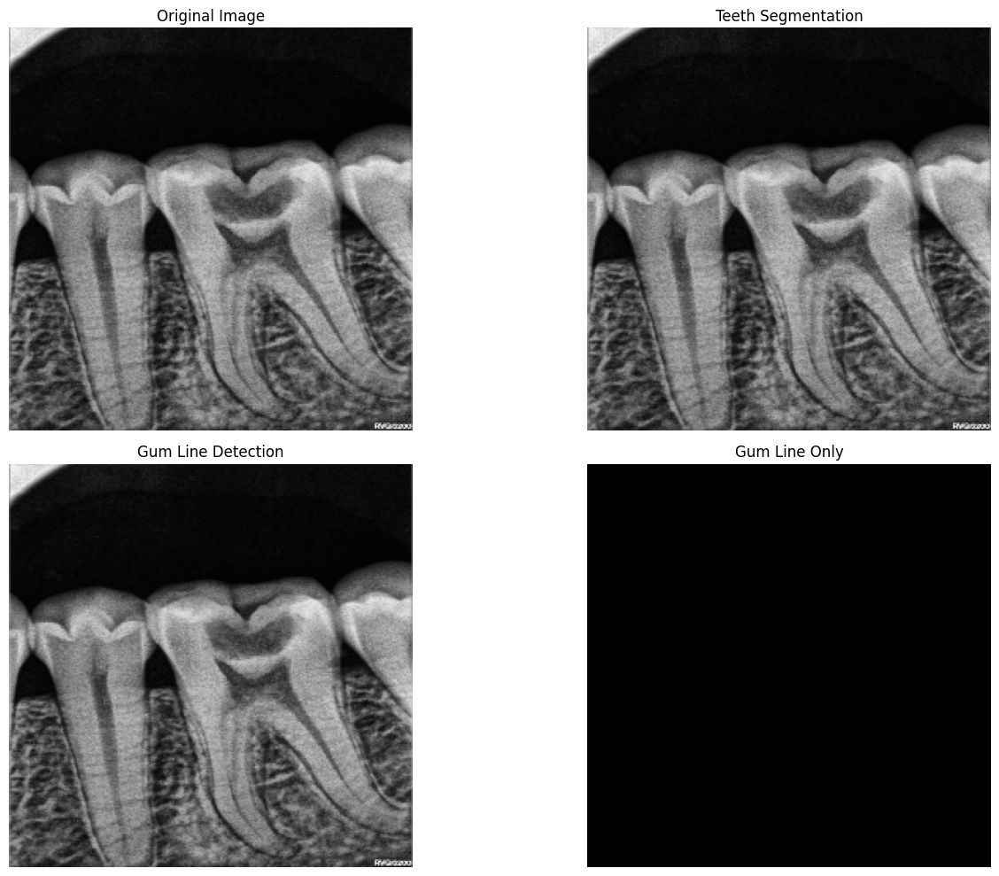

 90%|█████████████████████████████████████████████████████████████████████████▉        | 46/51 [00:55<00:06,  1.23s/it]

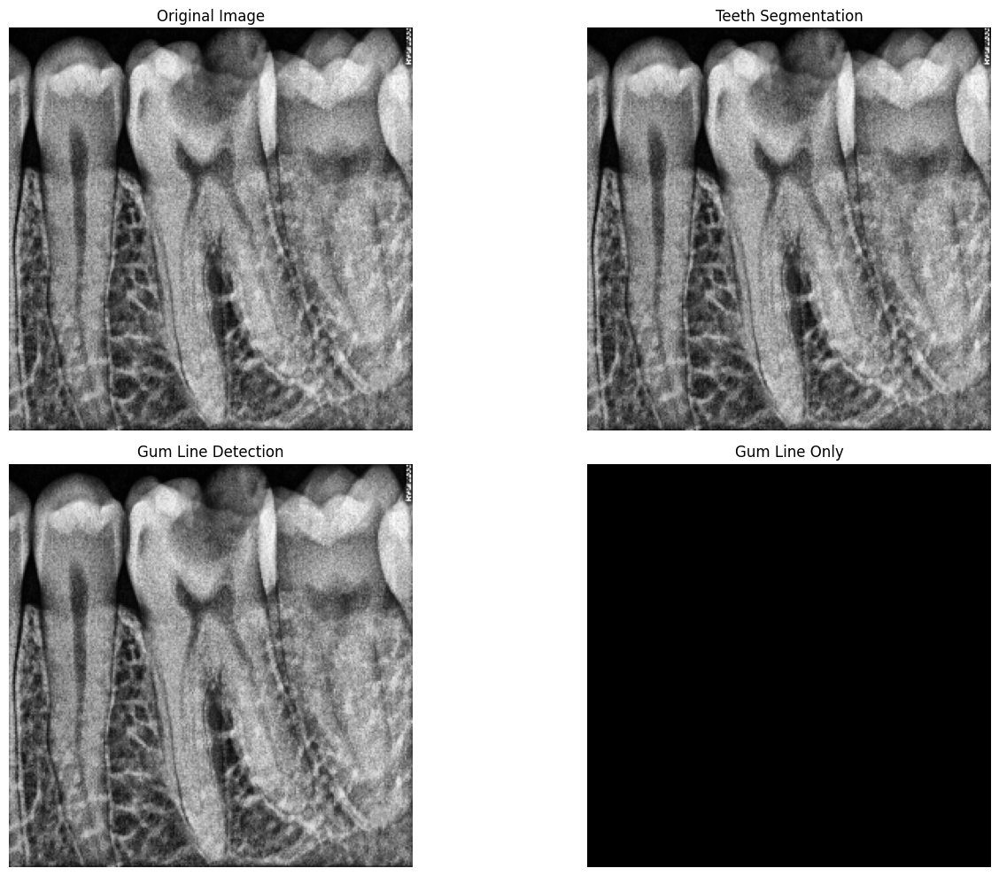

 92%|███████████████████████████████████████████████████████████████████████████▌      | 47/51 [00:56<00:04,  1.22s/it]

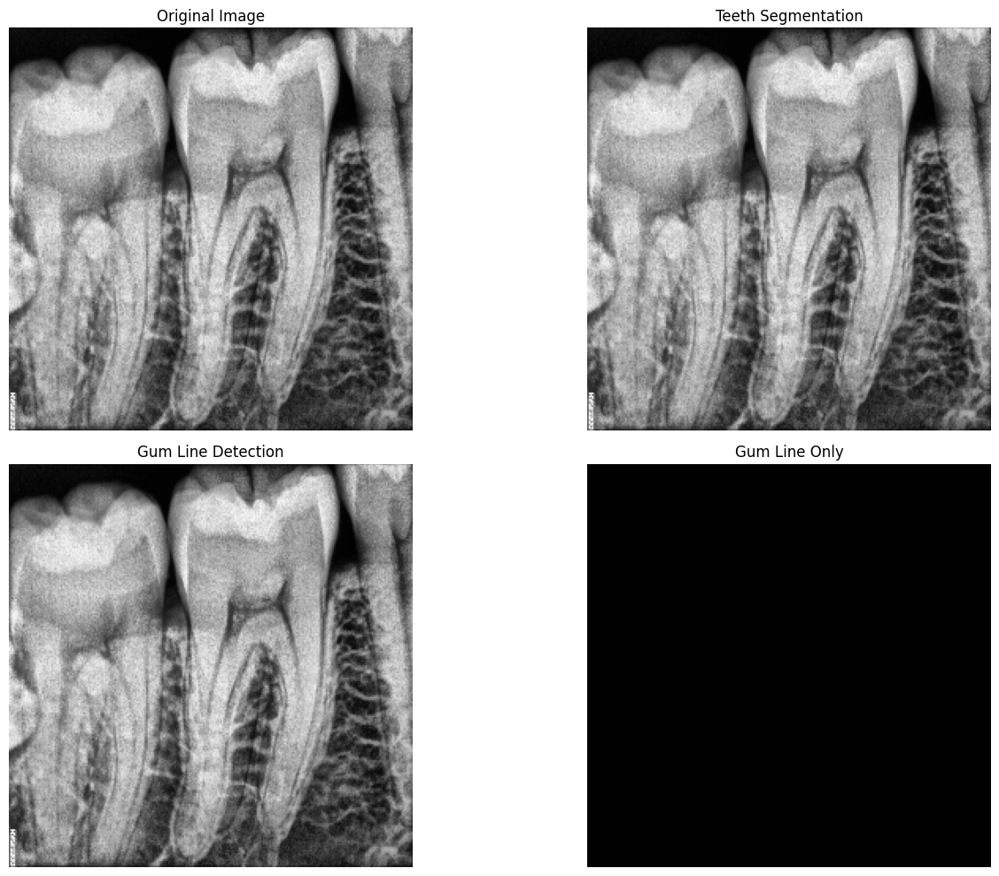

 94%|█████████████████████████████████████████████████████████████████████████████▏    | 48/51 [00:57<00:03,  1.21s/it]

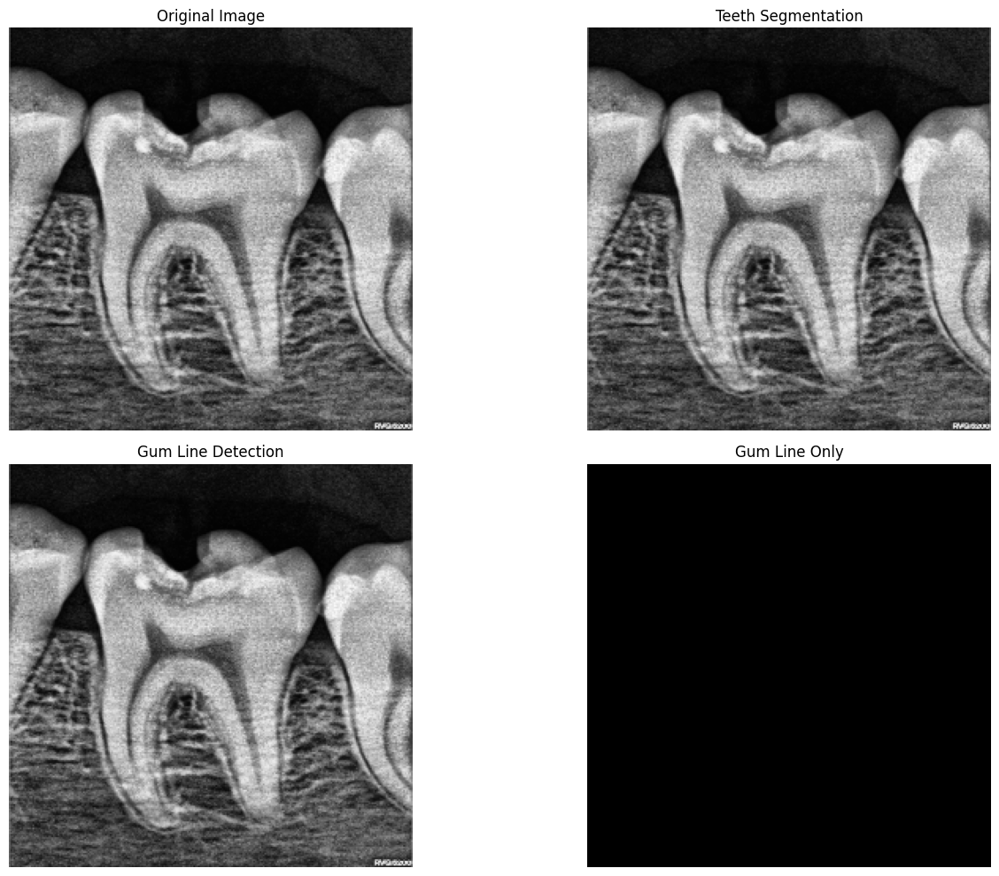

 96%|██████████████████████████████████████████████████████████████████████████████▊   | 49/51 [00:58<00:02,  1.20s/it]

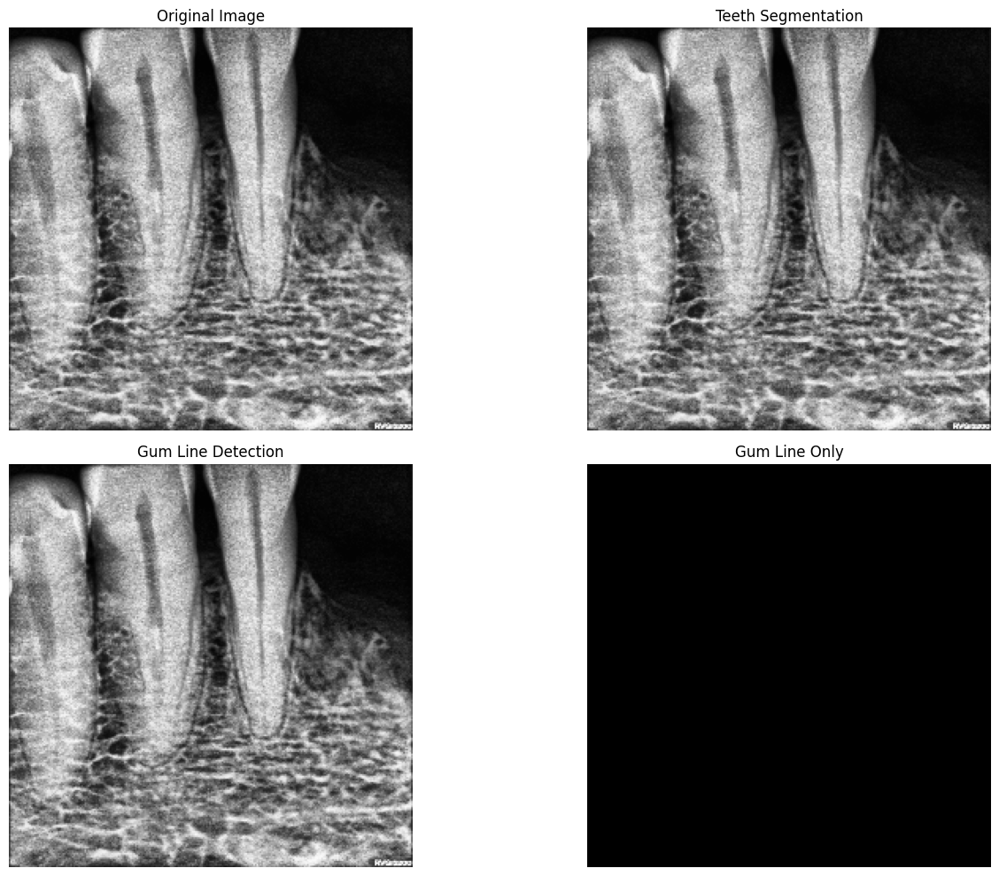

 98%|████████████████████████████████████████████████████████████████████████████████▍ | 50/51 [00:59<00:01,  1.19s/it]

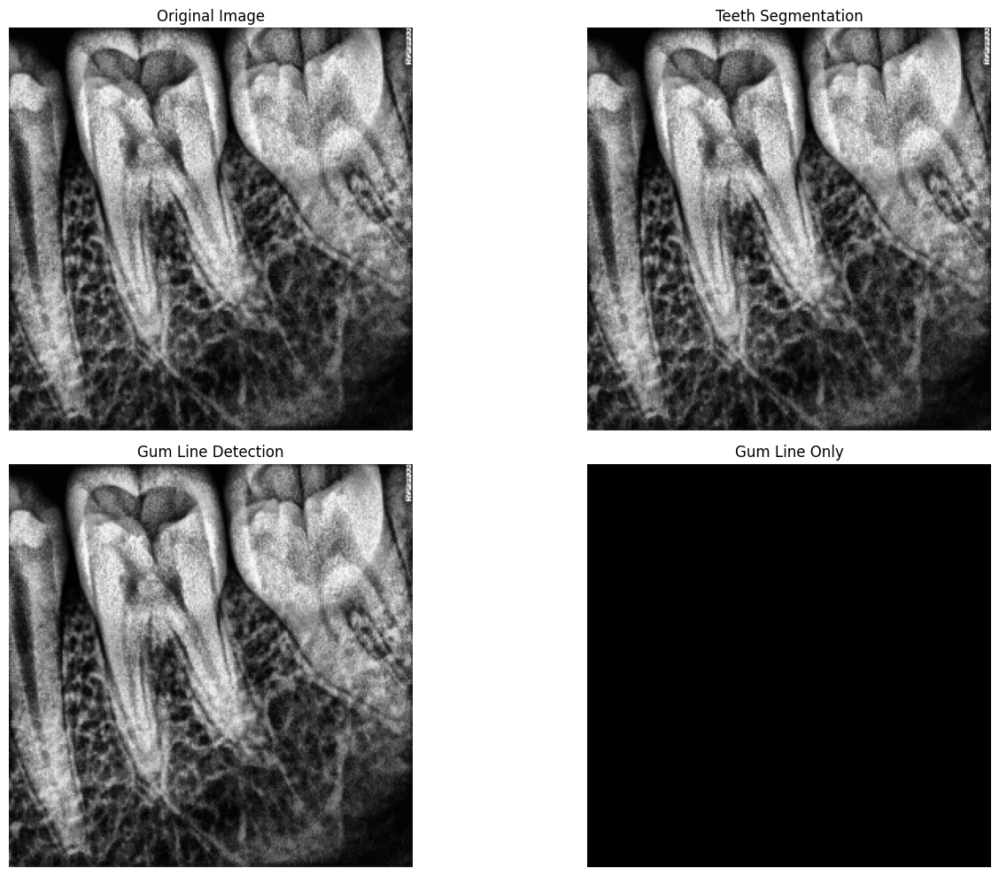

100%|██████████████████████████████████████████████████████████████████████████████████| 51/51 [01:00<00:00,  1.20s/it]

Successfully processed 51 images
Results saved to C:\Users\YASH CHAUDHARY\Desktop\programs\sampleoutput

Displaying sample result: result_image 3.jpg


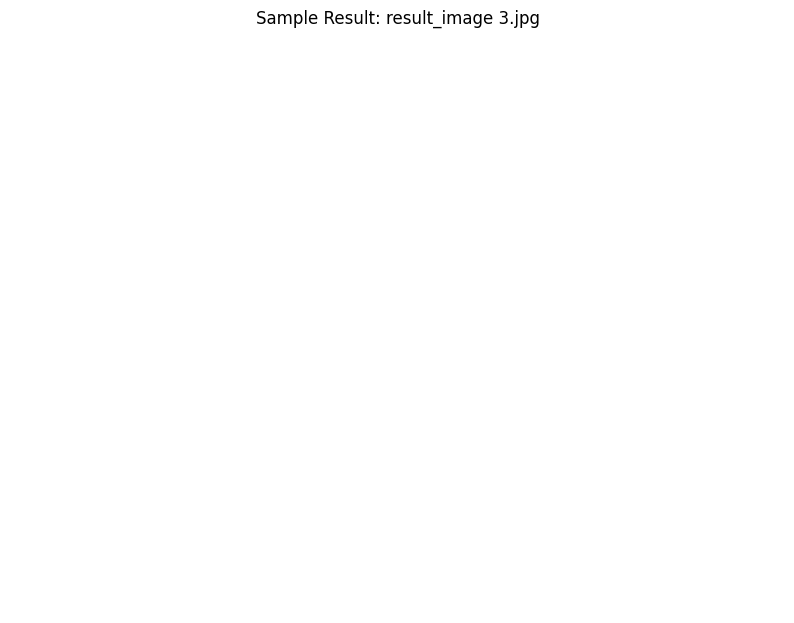

In [16]:
# Define paths for your input and output folders
input_folder = r"C:\Users\YASH CHAUDHARY\Desktop\programs\sample"  # Fixed with raw string prefix r
output_folder = r"C:\Users\YASH CHAUDHARY\Desktop\programs\sampleoutput"  # Fixed with raw string prefix r

# Initialize model and set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GumLineDetectionModel().to(device)
print(f"Using model on device: {device}")

# Process the batch of images
try:
    # Create output directory if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)
    
    # Get all image files from the input folder
    image_files = [f for f in os.listdir(input_folder) 
                  if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    
    if not image_files:
        print(f"No image files found in {input_folder}")
    else:
        print(f"Found {len(image_files)} images to process")
    
    # Process each image
    results = process_image_batch(input_folder, output_folder, model, device)
    
    # Display summary of processed results
    print(f"Successfully processed {len(results)} images")
    print(f"Results saved to {output_folder}")
    
    # Optional: Display a sample result to verify
    if len(results) > 0:
        result_files = os.listdir(output_folder)
        sample_files = [f for f in result_files if f.startswith("result_") and f.endswith(('.jpg', '.jpeg', '.png'))]
        
        if sample_files:
            sample_file = sample_files[0]
            print(f"\nDisplaying sample result: {sample_file}")
            sample_img = plt.imread(os.path.join(output_folder, sample_file))
            plt.figure(figsize=(10, 8))
            plt.imshow(sample_img)
            plt.title(f"Sample Result: {sample_file}")
            plt.axis('off')
            plt.show()
    
except Exception as e:
    print(f"Error processing batch: {e}")


In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d

def detect_gum_line(image_path):
    # Load image in grayscale
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    # Resize for processing
    height, width = img.shape
    aspect_ratio = width / height
    new_height = 512
    new_width = int(new_height * aspect_ratio)
    img_resized = cv2.resize(img, (new_width, new_height))
    
    # Enhance contrast
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    enhanced = clahe.apply(img_resized)
    
    # Detect gum line by analyzing brightness gradient in each column
    gum_line_y = []
    for x in range(new_width):
        column = enhanced[:, x]
        smoothed = gaussian_filter1d(column, sigma=2)
        gradient = np.gradient(smoothed)
        peak_index = np.argmax(gradient)
        gum_line_y.append(peak_index)
    
    # Smooth the curve
    gum_line_y = gaussian_filter1d(gum_line_y, sigma=5)
    
    # Create black background image for gum line only
    output_img = np.zeros_like(enhanced)
    
    # Draw the gum line points
    for x, y in enumerate(gum_line_y):
        y_int = int(y)
        if 0 <= y_int < new_height:
            output_img[y_int, x] = 255
    
    # Plot only the gum line (black background + white line)
    plt.figure(figsize=(10, 6))
    plt.imshow(output_img, cmap='gray')
    plt.title("Extracted Gum Line")
    plt.axis('off')
    plt.show()
    
    return gum_line_y


Found 51 images to process


Processing images: 100%|███████████████████████████████████████████████████████████████| 51/51 [00:07<00:00,  6.76it/s]


Successfully processed 51 images
Results saved to C:\Users\YASH CHAUDHARY\Desktop\programs\sampleoutput

Displaying sample result: C:\Users\YASH CHAUDHARY\Desktop\programs\sampleoutput\gum_line_image 3.jpg


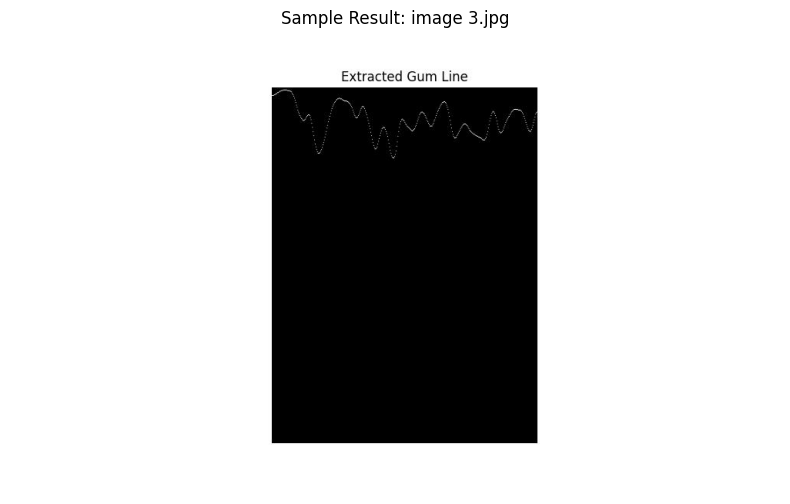

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
import os
from tqdm import tqdm
import json

def convert_to_serializable(obj):
    """Convert numpy types to native Python types for JSON serialization"""
    if isinstance(obj, dict):
        return {k: convert_to_serializable(v) for k, v in obj.items()}
    elif isinstance(obj, list):
        return [convert_to_serializable(i) for i in obj]
    elif isinstance(obj, tuple):
        return tuple(convert_to_serializable(i) for i in obj)
    elif isinstance(obj, np.integer):
        return int(obj)
    elif isinstance(obj, np.floating):
        return float(obj)
    else:
        return obj

def detect_gum_line(image_path, save_path=None):
    """Process a single dental radiograph for gum line detection"""
    # Load image in grayscale
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Could not load image {image_path}")
        return None
    
    # Resize for processing
    height, width = img.shape
    aspect_ratio = width / height
    new_height = 512
    new_width = int(new_height * aspect_ratio)
    img_resized = cv2.resize(img, (new_width, new_height))
    
    # Enhance contrast
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    enhanced = clahe.apply(img_resized)
    
    # Detect gum line by analyzing brightness gradient in each column
    gum_line_y = []
    for x in range(new_width):
        column = enhanced[:, x]
        smoothed = gaussian_filter1d(column, sigma=2)
        gradient = np.gradient(smoothed)
        # Focus on upper third for gum line
        peak_index = np.argmax(gradient[:new_height//3])  
        gum_line_y.append(peak_index)
    
    # Smooth the curve
    gum_line_y = gaussian_filter1d(gum_line_y, sigma=5)
    
    # Create black background image for gum line only
    output_img = np.zeros_like(enhanced)
    
    # Draw the gum line
    for x, y in enumerate(gum_line_y):
        y_int = int(y)
        if 0 <= y_int < new_height:
            output_img[y_int, x] = 255
    
    # Save the visualization if requested
    if save_path:
        plt.figure(figsize=(10, 6))
        plt.imshow(output_img, cmap='gray')
        plt.title("Extracted Gum Line")
        plt.axis('off')
        plt.savefig(save_path)
        plt.close()
    
    return {
        'gum_line_points': list(zip(range(new_width), gum_line_y.astype(int))),
        'image_dimensions': (new_width, new_height)
    }

def process_image_batch(input_folder, output_folder):
    """Process a batch of dental radiographs"""
    # Create output directory if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)
    
    # Get all image files
    image_files = [f for f in os.listdir(input_folder) 
                  if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    
    if not image_files:
        print(f"No image files found in {input_folder}")
        return
    
    print(f"Found {len(image_files)} images to process")
    
    # Process each image
    results = []
    for img_file in tqdm(image_files, desc="Processing images"):
        img_path = os.path.join(input_folder, img_file)
        save_path = os.path.join(output_folder, f"gum_line_{img_file}")
        
        try:
            # Process image
            result = detect_gum_line(img_path, save_path)
            
            if result:
                # Store results
                results.append({
                    'image_name': img_file,
                    'gum_line_points': result['gum_line_points']
                })
        except Exception as e:
            print(f"Error processing {img_file}: {e}")
    
    # Save aggregated results to JSON
    with open(os.path.join(output_folder, 'gum_line_results.json'), 'w') as f:
        # Convert NumPy types to native Python types
        serializable_results = convert_to_serializable(results)
        json.dump(serializable_results, f)
    
    print(f"Successfully processed {len(results)} images")
    print(f"Results saved to {output_folder}")
    
    # Display a sample result if available
    if results:
        sample_file = os.path.join(output_folder, f"gum_line_{image_files[0]}")
        if os.path.exists(sample_file):
            print(f"\nDisplaying sample result: {sample_file}")
            sample_img = plt.imread(sample_file)
            plt.figure(figsize=(10, 6))
            plt.imshow(sample_img)
            plt.title(f"Sample Result: {image_files[0]}")
            plt.axis('off')
            plt.show()

# Example usage
if __name__ == "__main__":
    # Replace these with your actual folder paths
    input_folder = r"C:\Users\YASH CHAUDHARY\Desktop\programs\sample"
    output_folder = r"C:\Users\YASH CHAUDHARY\Desktop\programs\sampleoutput"
    
    process_image_batch(input_folder, output_folder)


In [21]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d

# Load image in grayscale
img = cv2.imread("image 7.jpg", cv2.IMREAD_GRAYSCALE)

# Resize for processing (optional)
img_resized = cv2.resize(img, (256, 512))
height, width = img_resized.shape

# Detect gum line by analyzing brightness gradient in each column
gum_line_y = []
for x in range(width):
    column = img_resized[:, x]
    smoothed = gaussian_filter1d(column, sigma=2)
    gradient = np.gradient(smoothed)
    peak_index = np.argmax(gradient)
    gum_line_y.append(peak_index)

# Smooth the curve
gum_line_y = gaussian_filter1d(gum_line_y, sigma=5)

# Plot only the gum line (black background + red line)
plt.figure(figsize=(10, 6))
plt.title("Extracted Gum Line")
plt.plot(gum_line_y, color='red', linewidth=2)
plt.gca().invert_yaxis()  # Flip y-axis to match image orientation
plt.axis('off')
plt.show()

error: OpenCV(4.9.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:4152: error: (-215:Assertion failed) !ssize.empty() in function 'cv::resize'
